In [1]:
import pandas as pd
import numpy as np
import scipy as sc
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer
import re
from tqdm import tqdm
from wordcloud import WordCloud
from sklearn.preprocessing import LabelEncoder

# reading data

In [2]:
# reading data
df=pd.read_csv('mercari-price-suggestion-challenge/train.tsv', sep='\t')
df.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description
0,0,MLB Cincinnati Reds T Shirt Size XL,3,Men/Tops/T-shirts,NaN,10.0,1,No description yet
1,1,Razer BlackWidow Chroma Keyboard,3,Electronics/Computers & Tablets/Components & P...,Razer,52.0,0,This keyboard is in great condition and works ...
2,2,AVA-VIV Blouse,1,Women/Tops & Blouses/Blouse,Target,10.0,1,Adorable top with a hint of lace and a key hol...
3,3,Leather Horse Statues,1,Home/Home Décor/Home Décor Accents,NaN,35.0,1,New with tags. Leather horses. Retail for [rm]...
4,4,24K GOLD plated rose,1,Women/Jewelry/Necklaces,NaN,44.0,0,Complete with certificate of authenticity


In [3]:
df.describe()

,train_id,item_condition_id,price,shipping
count,1.482535e+06,1.482535e+06,1.482535e+06,1.482535e+06
mean,7.412670e+05,1.907380e+00,2.673752e+01,4.472744e-01
std,4.279711e+05,9.031586e-01,3.858607e+01,4.972124e-01
min,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00
25%,3.706335e+05,1.000000e+00,1.000000e+01,0.000000e+00
50%,7.412670e+05,2.000000e+00,1.700000e+01,0.000000e+00
75%,1.111900e+06,3.000000e+00,2.900000e+01,1.000000e+00
max,1.482534e+06,5.000000e+00,2.009000e+03,1.000000e+00


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1482535 entries, 0 to 1482534
Data columns (total 8 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   train_id           1482535 non-null  int64  
 1   name               1482535 non-null  object 
 2   item_condition_id  1482535 non-null  int64  
 3   category_name      1476208 non-null  object 
 4   brand_name         849853 non-null   object 
 5   price              1482535 non-null  float64
 6   shipping           1482535 non-null  int64  
 7   item_description   1482531 non-null  object 
dtypes: float64(1), int64(3), object(4)
memory usage: 90.5+ MB


train_id and name and item_condition_id and price and shipping have no null values where as brand_name and category_name and item_description have some null values.
train_id is just id so we will not do analysis on this.

In [7]:
df=df.dropna(subset=['category_name'])

# preprocessing text data

In [4]:
# removing not from stop words
stop_words= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [5]:
def decontracted(phrase):
    # specific
    # in this function we are converting some short form to full form like won't to will not
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [6]:
# some cleaning on text data

stop_words=stopwords.words('english')
lemmatizer_=WordNetLemmatizer()
def preprocess_text_data(values):
    preprocessed_text=[]
    for sen in tqdm(values):
        sen=str(sen).lower()
        sen=decontracted(sen)
        # removing special characters
        sen=sen.replace("'s",' is').replace("’",'').replace('!','').replace(',',' ').replace('-',' ').replace('.','').replace('(','').replace(')','')\
            .replace('\r','').replace('\n','').replace('\"','').replace('&','').replace('=','').replace('?','').replace(':','').replace("'re",' are')\
            .replace("'ve",' have').replace("'m",' am').replace("'t",' not').replace("...",' ').replace("....",' ').replace('\\r','').replace('\\n','')\
            .replace('\\','').replace('*','').replace("'",'').replace(";",'').replace("+",'').replace("%",'').replace("  ",' ')
        
        sen=sen.replace('/',' ').replace('[',' ').replace(']',' ').replace('⚡️','').replace('✨','').replace('❤️','').replace('#','').replace('$','')
        # lemmatizing each word in sentences
        sen = ' '.join(lemmatizer_.lemmatize(e) for e in sen.split() if e.lower() not in stop_words and len(e)>2)
        # except a-z and A-Z remove all things from sentence.
        sen = re.sub('[^a-zA-Z \n\.]', '', sen)
        #sen = re.sub(" \d+", " ", sen)
        # reference -- https://stackoverflow.com/questions/33404752/removing-emojis-from-a-string-in-python
        regrex_pattern = re.compile(pattern = "["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           "]+", flags = re.UNICODE)
        sen=regrex_pattern.sub(r'',sen)
        preprocessed_text.append(sen.strip())
    return preprocessed_text

    

## preprocessing name column

In [11]:
df['name'].value_counts()

Bundle                                    2211
Reserved                                   449
Converse                                   443
BUNDLE                                     414
Dress                                      409
                                          ... 
Set of four coffee cups                      1
FLASH SALE!! LULAROE BNWT TC LEGGING!!       1
Reserved. Gap wool coat, 3T                  1
Men checkered Wallet.                        1
Lipsense anycolor with 2 glosses             1
Name: name, Length: 1220180, dtype: int64

In [12]:
df['name']=preprocess_text_data(df['name'].values)

100%|█████████████████████████████████████████████████████████████████████| 1476208/1476208 [01:09<00:00, 21253.76it/s]
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [13]:
df.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description
0,0,mlb cincinnati red shirt size,3,Men/Tops/T-shirts,NaN,10.0,1,No description yet
1,1,razer blackwidow chroma keyboard,3,Electronics/Computers & Tablets/Components & P...,Razer,52.0,0,This keyboard is in great condition and works ...
2,2,ava viv blouse,1,Women/Tops & Blouses/Blouse,Target,10.0,1,Adorable top with a hint of lace and a key hol...
3,3,leather horse statue,1,Home/Home Décor/Home Décor Accents,NaN,35.0,1,New with tags. Leather horses. Retail for [rm]...
4,4,k gold plated rose,1,Women/Jewelry/Necklaces,NaN,44.0,0,Complete with certificate of authenticity


In [14]:
df['brand_name']=df['brand_name'].apply(lambda x:str(x).lower())

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


## preprocessing category name

In [16]:
df['category_name'].value_counts()

Women/Athletic Apparel/Pants, Tights, Leggings    60177
Women/Tops & Blouses/T-Shirts                     46380
Beauty/Makeup/Face                                34335
Beauty/Makeup/Lips                                29910
Electronics/Video Games & Consoles/Games          26557
                                                  ...  
Handmade/Patterns/Accessories                         1
Vintage & Collectibles/Furniture/Storage              1
Handmade/Furniture/Shelf                              1
Home/Home Appliances/Garbage Disposals                1
Handmade/Woodworking/Seasonal                         1
Name: category_name, Length: 1287, dtype: int64

In [17]:
df['category_name']=df['category_name'].apply(lambda x:str(x))

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [18]:
df['category_name_len']=df['category_name'].apply(lambda x:len(x.split('/')))

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [19]:
df[df['category_name_len']==5]

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,category_name_len
239,239,zagg invisible shield ipad air,1,Electronics/Computers & Tablets/iPad/Tablet/eB...,nan,10.0,1,Zag invisible shield for IPad air,5
742,742,ipad pro smart cover,2,Electronics/Computers & Tablets/iPad/Tablet/eB...,nan,31.0,0,iPad Pro Smart Cover in Lilac Made for iPad Pr...,5
1700,1700,like new kobo ereader tablet,1,Electronics/Computers & Tablets/iPad/Tablet/eB...,nan,31.0,0,Selling a tablet literally like new. No scratc...,5
2923,2923,vuru tablet inch,3,Electronics/Computers & Tablets/iPad/Tablet/eB...,nan,26.0,0,Vuru tablet. Perfect for children. It does hav...,5
3394,3394,ipod st generation gb,5,Electronics/Computers & Tablets/iPad/Tablet/eB...,apple,20.0,1,For parts or repair,5
...,...,...,...,...,...,...,...,...,...
1480808,1480808,coach ipad case,3,Electronics/Computers & Tablets/iPad/Tablet/eB...,nan,39.0,0,Good condition,5
1481238,1481238,kindle,2,Electronics/Computers & Tablets/iPad/Tablet/eB...,amazonbasics,24.0,0,No description yet,5
1481848,1481848,samsung tab,2,Electronics/Computers & Tablets/iPad/Tablet/eB...,samsung,35.0,1,Hardly ever used. No damage still has screen p...,5
1482283,1482283,kindle fire,3,Electronics/Computers & Tablets/iPad/Tablet/eB...,amazonbasics,51.0,0,This is a Kindle Fire HD. This is 7 inches. Wi...,5


In [20]:
df['subcat1']=df['category_name'].apply(lambda x:x.split('/')[0])
df['subcat2']=df['category_name'].apply(lambda x:x.split('/')[1])
df['subcat3']=df['category_name'].apply(lambda x:x.split('/')[2])

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

In [7]:
def subcat4_fun(x):
    try:
        c=x.split('/')[3]
    except:
        c='nan'
    return c    
        
def subcat5_fun(x):
    try:
        c=x.split('/')[4]
    except:
        c='nan'
    return c  

In [24]:
df['subcat4']=df['category_name'].apply(subcat4_fun)
df['subcat5']=df['category_name'].apply(subcat5_fun)

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [25]:
df.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,category_name_len,subcat1,subcat2,subcat3,subcat4,subcat5
0,0,mlb cincinnati red shirt size,3,Men/Tops/T-shirts,nan,10.0,1,No description yet,3,Men,Tops,T-shirts,nan,nan
1,1,razer blackwidow chroma keyboard,3,Electronics/Computers & Tablets/Components & P...,razer,52.0,0,This keyboard is in great condition and works ...,3,Electronics,Computers & Tablets,Components & Parts,nan,nan
2,2,ava viv blouse,1,Women/Tops & Blouses/Blouse,target,10.0,1,Adorable top with a hint of lace and a key hol...,3,Women,Tops & Blouses,Blouse,nan,nan
3,3,leather horse statue,1,Home/Home Décor/Home Décor Accents,nan,35.0,1,New with tags. Leather horses. Retail for [rm]...,3,Home,Home Décor,Home Décor Accents,nan,nan
4,4,k gold plated rose,1,Women/Jewelry/Necklaces,nan,44.0,0,Complete with certificate of authenticity,3,Women,Jewelry,Necklaces,nan,nan


## preprocessing item_description column data

In [27]:
df['item_description'][865]

'24Pcs Professional Makeup Brush set+Black Pouch Bag Cosmetic Brushes This item includes almost all brushes for facial makeup: 24 soft and durable goat hair brushes altogether. It`s a good choice for makeup artists and all trendsetters. Features: Total 24 brushes for facial makeup: Foundation Brush, Concealer Brush, Eyeshadow Brush, Eyebrow Brush, Blush Brush, Lip Brush, Mascara Brush... Adopts natural pure goat hair which provides superb ability to hold powerder, soft and pleasing for your skin. Gorgeous purple soft leather bag, easy to collect and carry brushes. An essential for not only professionals but also DIY users. Specifications: Material: Goat hair, aluminum, wood, and PU Bag size: 23 * 13 * 4cm (folded) Product weight: 414g Item Includes: 1 * Makeup Brush Set'

In [28]:
df['item_description']=preprocess_text_data(df['item_description'].values)

100%|██████████████████████████████████████████████████████████████████████| 1476208/1476208 [03:18<00:00, 7447.36it/s]
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [29]:
df['item_description']=df['item_description'].apply(lambda x:'_'.join(x.split()) if x == 'description yet' else x)

C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [30]:
df.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,category_name_len,subcat1,subcat2,subcat3,subcat4,subcat5
0,0,mlb cincinnati red shirt size,3,Men/Tops/T-shirts,nan,10.0,1,description_yet,3,Men,Tops,T-shirts,nan,nan
1,1,razer blackwidow chroma keyboard,3,Electronics/Computers & Tablets/Components & P...,razer,52.0,0,keyboard great condition work like came box po...,3,Electronics,Computers & Tablets,Components & Parts,nan,nan
2,2,ava viv blouse,1,Women/Tops & Blouses/Blouse,target,10.0,1,adorable top hint lace key hole back pale pink...,3,Women,Tops & Blouses,Blouse,nan,nan
3,3,leather horse statue,1,Home/Home Décor/Home Décor Accents,nan,35.0,1,new tag leather horse retail stand foot high s...,3,Home,Home Décor,Home Décor Accents,nan,nan
4,4,k gold plated rose,1,Women/Jewelry/Necklaces,nan,44.0,0,complete certificate authenticity,3,Women,Jewelry,Necklaces,nan,nan


# name column EDA

it has no null values.

In [31]:
df.to_csv('preprocessed.csv',index=False)

In [8]:
df=pd.read_csv('preprocessed.csv')

In [9]:
df['item_description']=df['item_description'].apply(lambda x:str(x))
df['category_name']=df['category_name'].apply(lambda x:str(x))
df['brand_name']=df['brand_name'].apply(lambda x:str(x))
df['name']=df['name'].apply(lambda x:str(x))

In [10]:
# df['category_name']=category_namezs

<h1 style='color:red'>plot 1</h1>

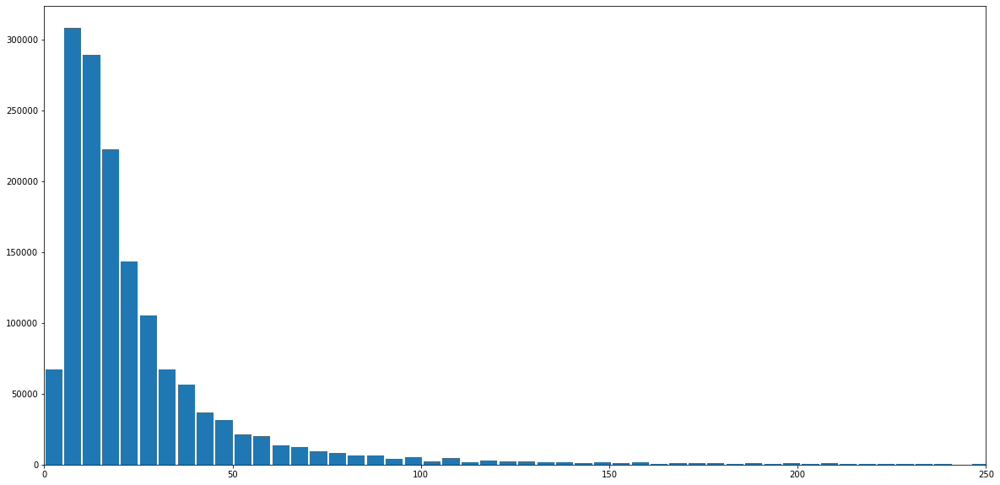

In [11]:
plt.figure(figsize=(20,10))
plt.hist(df['price'],bins=400,rwidth=0.9)
plt.xlim(0,250)
plt.show()

this plot is showing the distribution of price, there are more products with less price and less products with high price.

<h1 style='color:red'>plot 2</h1>

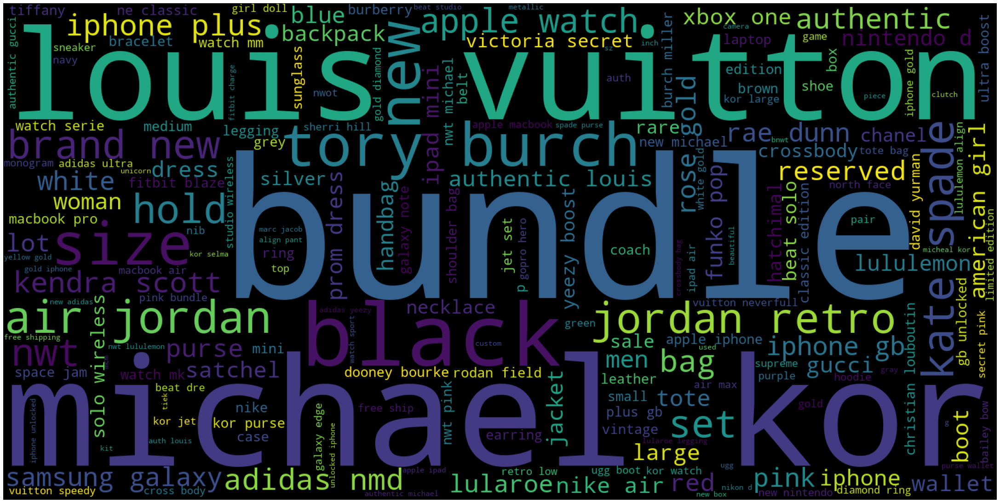

In [12]:
sentences=''
for i in df[df['price']>=100]['name'].values:
    sentences+=str(i)+' '
sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

here i am making the wordcloud of names which price is greater than 100, so the word which are large in wordcloud they are more frequent and we can say that it can be possible that this most occured word have causes price greater than 100.

<h1 style='color:red'>plot 3</h1>

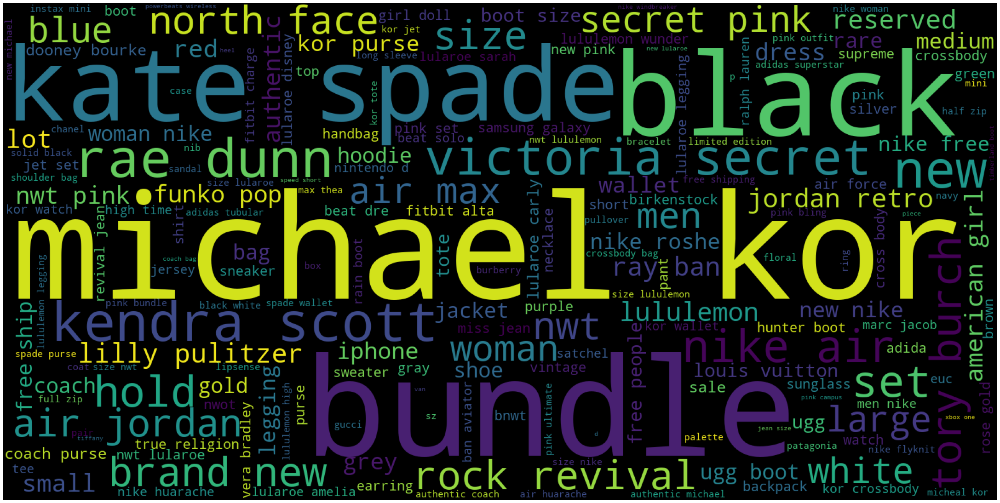

In [33]:
sentences=''
for i in df[(df['price']<=100) & (df['price']>=50)]['name'].values:
    sentences+=str(i)+' '
sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

plot 2 and plot 3 are similar so the which are large in 1 are also large in this wordcloud so i think the these large words like michael kor and etc are causing the price higher than 50.

<h1 style='color:red'>plot 4</h1>

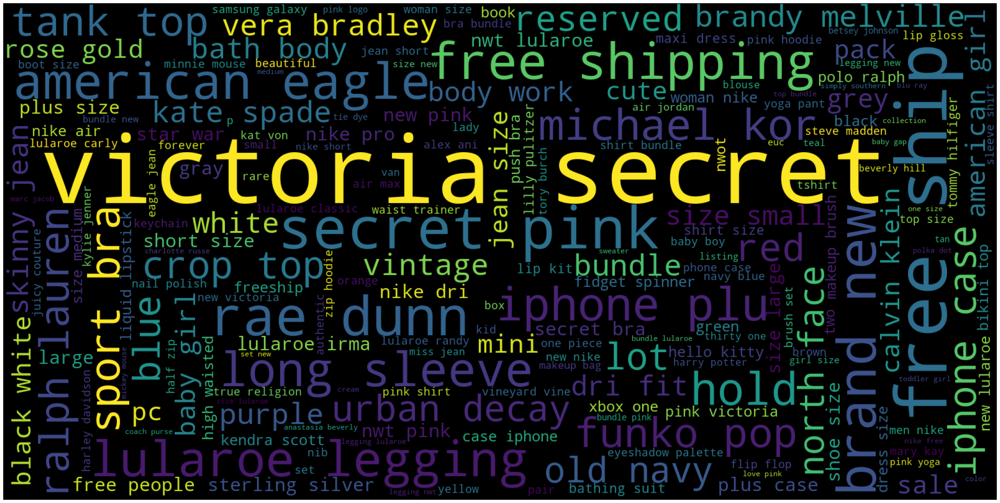

In [47]:
sentences=''
for i in df[df['price']<=50]['name'].values:
    sentences+=str(i)+' '
sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

this wordcloud have word small in size which are large in size in wordcloud 1 and wordcloud 2. here the word victoria secret is large so this can have some effect on product which have price less than 50.

<h1 style='color:red'>plot 5</h1>

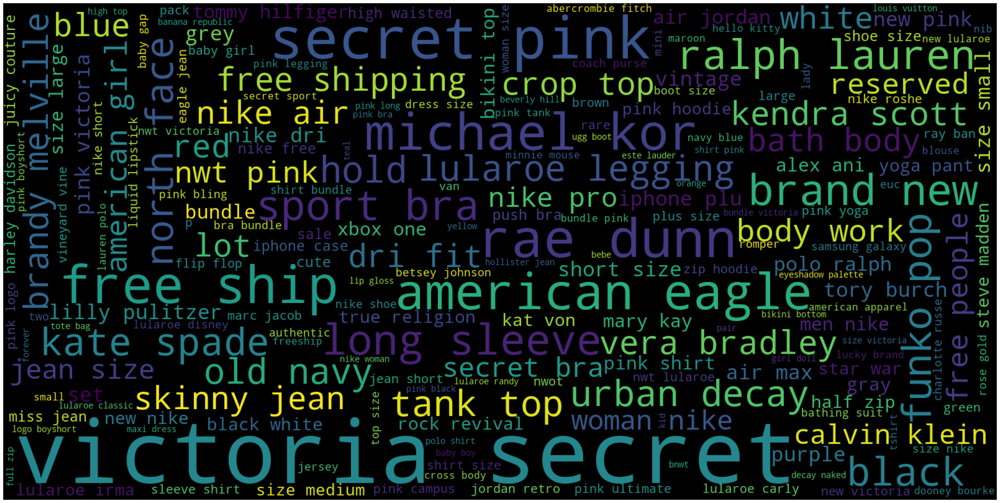

In [29]:
sentences=''
for i in df[df['price']<=100]['name'].values:
    sentences+=str(i)+' '
sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

In [13]:
def plotting_wordcloud(column_name):   
    sentences=''
    for i in df[column_name].values:
        sentences+=str(i)+' '
    sentences=sentences.strip()    
    wordcloud = WordCloud(background_color='black',
                              width=1600,
                              height=800,
                        ).generate(sentences)

    fig = plt.figure(figsize=(30,20))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.tight_layout(pad=0)

In [14]:
df['name'].values

array(['mlb cincinnati red shirt size',
       'razer blackwidow chroma keyboard', 'ava viv blouse', ...,
       'day fix container eating plan', 'world market lantern',
       'brand new lux ville wallet'], dtype=object)

In [15]:
length_of_sentences=[]
for i in df['name'].values:
    length_of_sentences.append(len(i))

In [16]:
len(length_of_sentences)

1476208

<h1 style='color:red'>plot 6</h1>

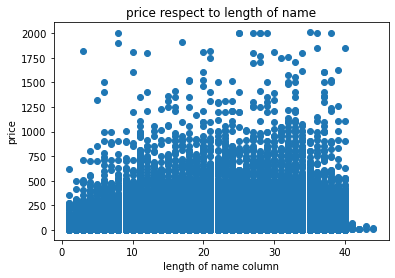

In [17]:
plt.scatter(length_of_sentences,df['price'])
plt.title('price respect to length of name')
plt.xlabel('length of name column')
plt.ylabel('price')
plt.show()

here i am plotting price respect to length of each name. we can see how price belongs to length of name.

In [18]:
each_sentence_word=[]
for i in df['name'].values:
    each_sentence_word.append(len(i.split()))

<h1 style='color:red'>plot 7</h1>

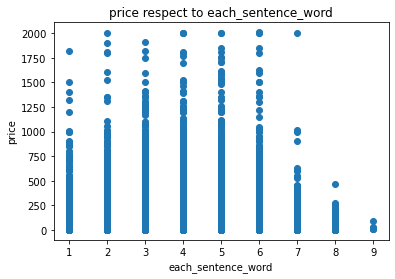

In [19]:
plt.scatter(each_sentence_word,df['price'])
plt.title('price respect to each_sentence_word')
plt.xlabel('each_sentence_word')
plt.ylabel('price')
plt.show()

here i am plotting price respect to words in each name. we can see as the words are increasing in product_name the price is decreasing and when the number of words is 4,5,6 then the price is low also and high also.

In [20]:
df['name_each_sen_word']=each_sentence_word

In [21]:
words=[]
for i in df['name'].values:
    for j in i.split():
        words.append(j)

In [22]:
print('we have only {} unique words'.format(len(set(words))))

we have only 95990 unique words


In [23]:
# # we are making df from word
# df_name=pd.DataFrame(words)
# # we are doing value counts so that we can find frequencies of each word
# df_name=pd.DataFrame(df_name[0].value_counts())
# for i in range(0,201):
#     samp=df_name[df_name[0]<=i]
#     perc=100*(samp.shape[0]/df_name.shape[0])
#     print('the percentage of word which have frequencies less than {} is '.format(i),perc)

# item_condition_id eda

there is no missing data in this column also.

In [24]:
df['item_condition_id']

0          3
1          3
2          1
3          1
4          1
          ..
1476203    2
1476204    2
1476205    2
1476206    3
1476207    1
Name: item_condition_id, Length: 1476208, dtype: int64

<h1 style='color:red'>plot 8</h1>

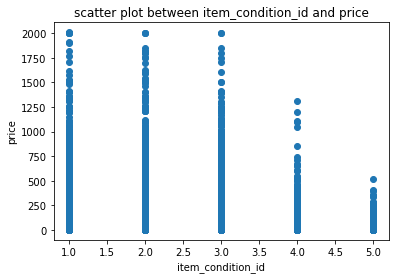

In [25]:
plt.scatter(df['item_condition_id'],df['price'])
plt.title('scatter plot between item_condition_id and price')
plt.xlabel('item_condition_id')
plt.ylabel('price')
plt.show()

in the above scatter plot when the condition_id is 5 then the price is always less than 750 and when the item condition_id is 4 then there are some products which have price higher than 750 and for condition_id 1,2,3 the price is low also and high also, and it is clear that there are more datapoints with item_condition_id 1, 2 and 3.

In [26]:
sc.stats.spearmanr(df['item_condition_id'],df['price'])

SpearmanrResult(correlation=-0.008803056921468072, pvalue=1.0643835150195557e-26)

the corelation between item_condition_id and price is almost 0.

<h1 style='color:red'>plot 9</h1>

(0.0, 500.0)

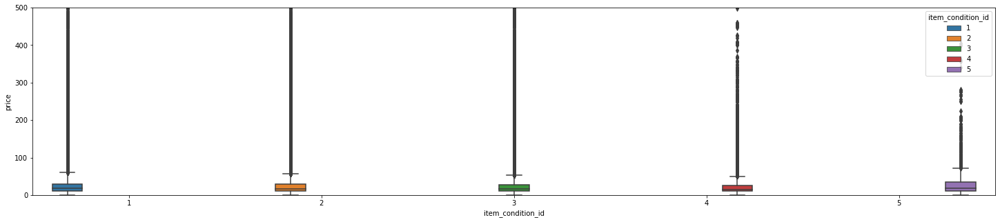

In [27]:
plt.figure(figsize=(25,5))
sns.boxplot(x=df['item_condition_id'],y=df['price'],hue=df['item_condition_id'])
plt.ylim(0,500)

(0.0, 100.0)

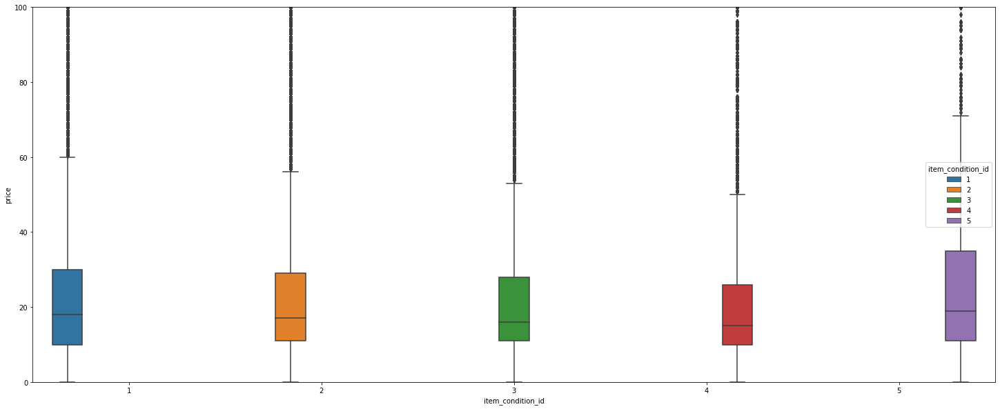

In [28]:
plt.figure(figsize=(25,10))
sns.boxplot(x=df['item_condition_id'],y=df['price'],hue=df['item_condition_id'])
plt.ylim(0,100)


plotting the box-plot between product price and product condition_id. this plot shows the range of price with respect to each condition_id.

<h1 style='color:red'>plot 10</h1>

(-30.0, 200.0)

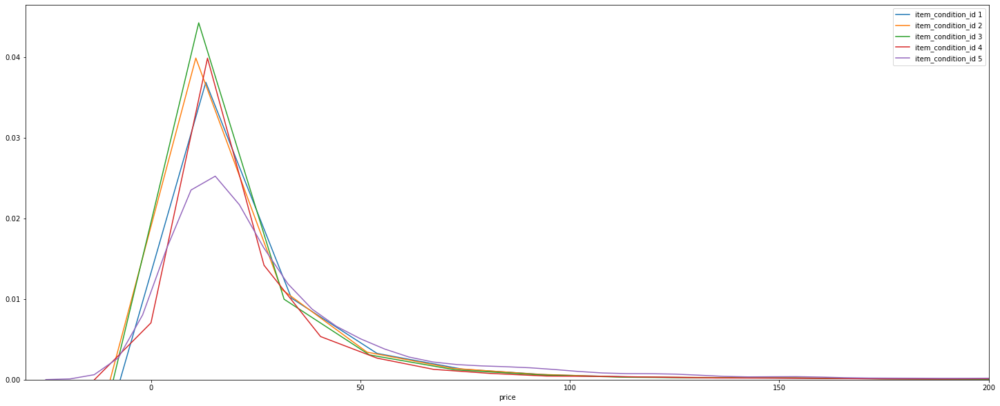

In [29]:
plt.figure(figsize=(25,10))
sns.distplot(df[df['item_condition_id']==1]['price'],bins=400,label='item_condition_id 1',hist=False)
sns.distplot(df[df['item_condition_id']==2]['price'],bins=400,label='item_condition_id 2',hist=False)
sns.distplot(df[df['item_condition_id']==3]['price'],bins=400,label='item_condition_id 3',hist=False)
sns.distplot(df[df['item_condition_id']==4]['price'],bins=400,label='item_condition_id 4',hist=False)
sns.distplot(df[df['item_condition_id']==5]['price'],bins=400,label='item_condition_id 5',hist=False)
plt.legend()
plt.xlim(-30,200)

(0.0, 0.0001)

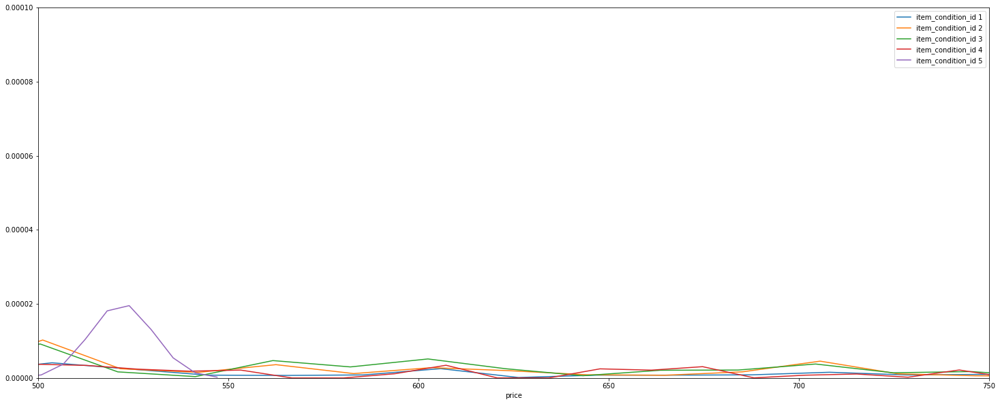

In [30]:
plt.figure(figsize=(25,10))
sns.distplot(df[df['item_condition_id']==1]['price'],bins=400,label='item_condition_id 1',hist=False)
sns.distplot(df[df['item_condition_id']==2]['price'],bins=400,label='item_condition_id 2',hist=False)
sns.distplot(df[df['item_condition_id']==3]['price'],bins=400,label='item_condition_id 3',hist=False)
sns.distplot(df[df['item_condition_id']==4]['price'],bins=400,label='item_condition_id 4',hist=False)
sns.distplot(df[df['item_condition_id']==5]['price'],bins=400,label='item_condition_id 5',hist=False)
plt.legend()
plt.xlim(500,750)
plt.ylim(0,.0001)

<h1 style='color:red'>plot 11</h1>

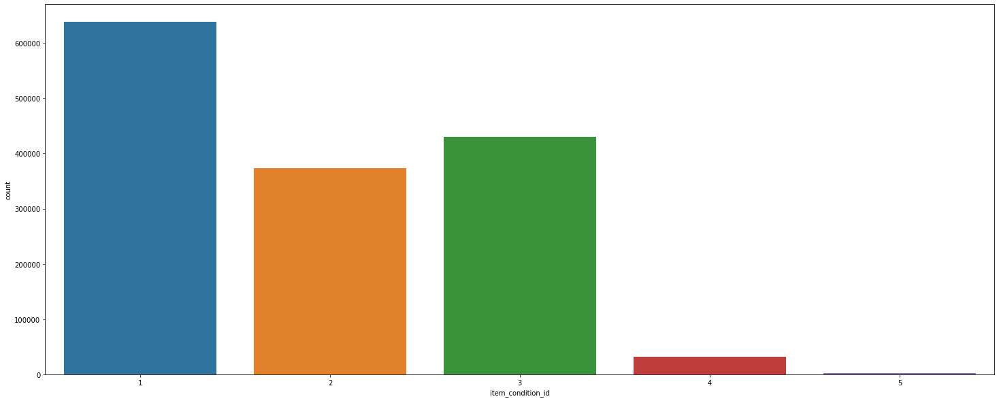

In [31]:
plt.figure(figsize=(25,10))
sns.countplot(df['item_condition_id'])

there is very less datapoints which have item_condition_id 4 or 5.

# category name EDA

## subcat1

<h1 style='color:red'>plot 12</h1>

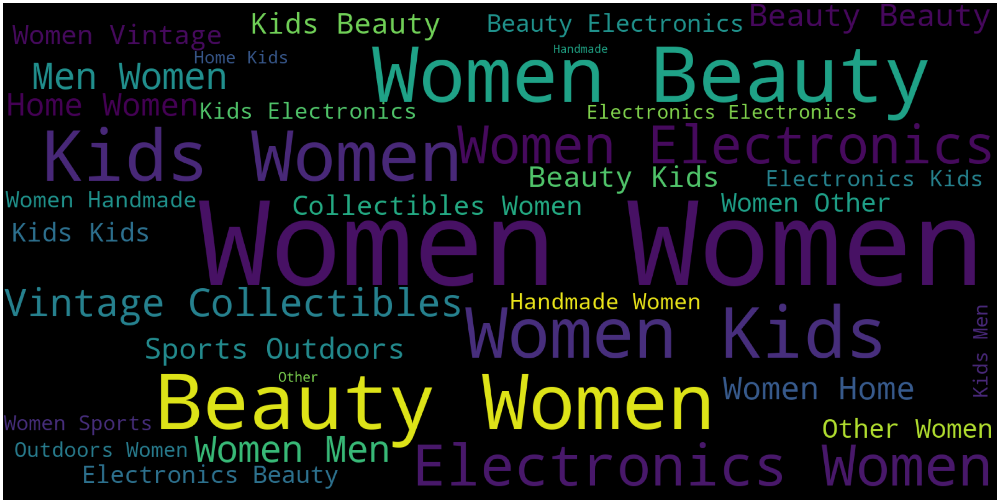

In [227]:
# plotting_wordcloud('category_name')
sentences=''
for i in df['subcat1'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

wordcloud of subcat_1 column, i can see here women, beauty kids have occured more.

In [32]:
df['subcat1'].value_counts()

Women                     664385
Beauty                    207828
Kids                      171689
Electronics               122690
Men                        93680
Home                       67871
Vintage & Collectibles     46530
Other                      45351
Handmade                   30842
Sports & Outdoors          25342
Name: subcat1, dtype: int64

<h1 style='color:red'>plot 13</h1>

(0.0, 100.0)

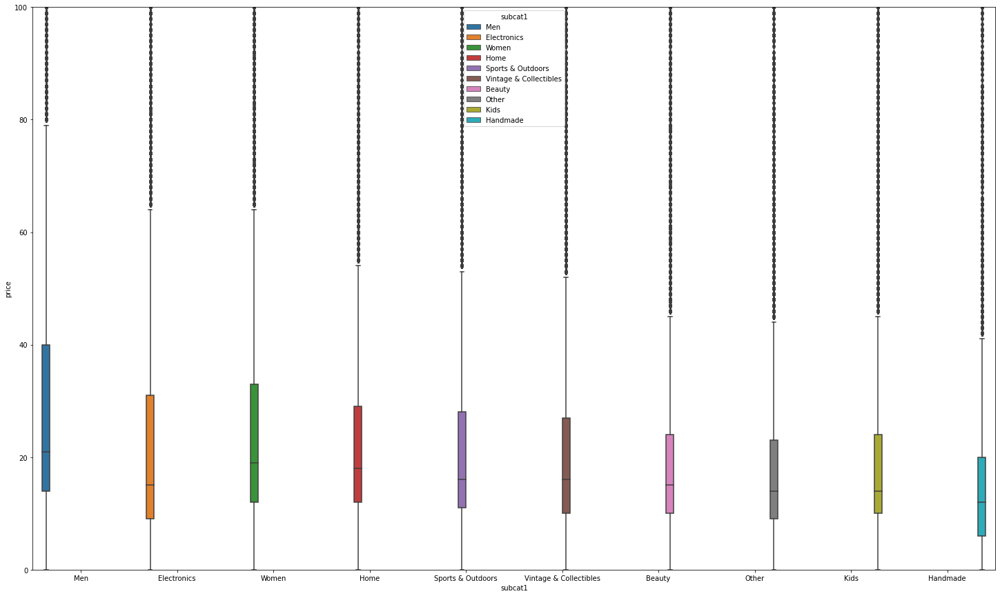

In [33]:
plt.figure(figsize=(25,15))
# df_category_name = df[(df['subcat1']=='Women') | (df['subcat1']=='Beauty') | (df['subcat1']=='Kids') | (df['subcat1']=='Electronics') | (df['subcat1']=='Men')]
sns.boxplot(x=df['subcat1'],y=df['price'],hue=df['subcat1'])
plt.ylim(0,100)

this plot is showing ranges and distribution of prices regarding each subcat_1. from this plot we can see that product price range with each subcat1 are overlapping but there are little bit difference in each subcat1 product prices, we can see difference between where the subcat1 is men and where the subcat1 is handmade.

<h1 style='color:red'>plot 14</h1>

(-30.0, 150.0)

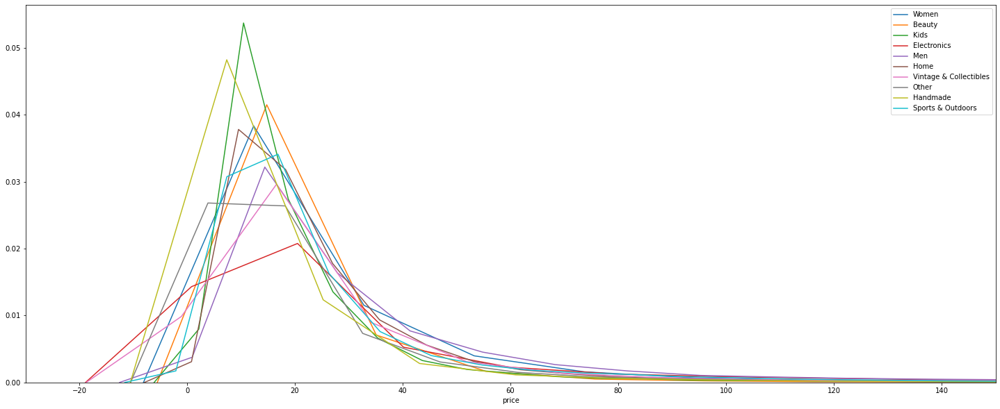

In [34]:
plt.figure(figsize=(25,10))
for i in list(df['subcat1'].value_counts().index):
    sns.distplot(df[df['subcat1']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,150) 

<h1 style='color:red'>plot 15</h1>

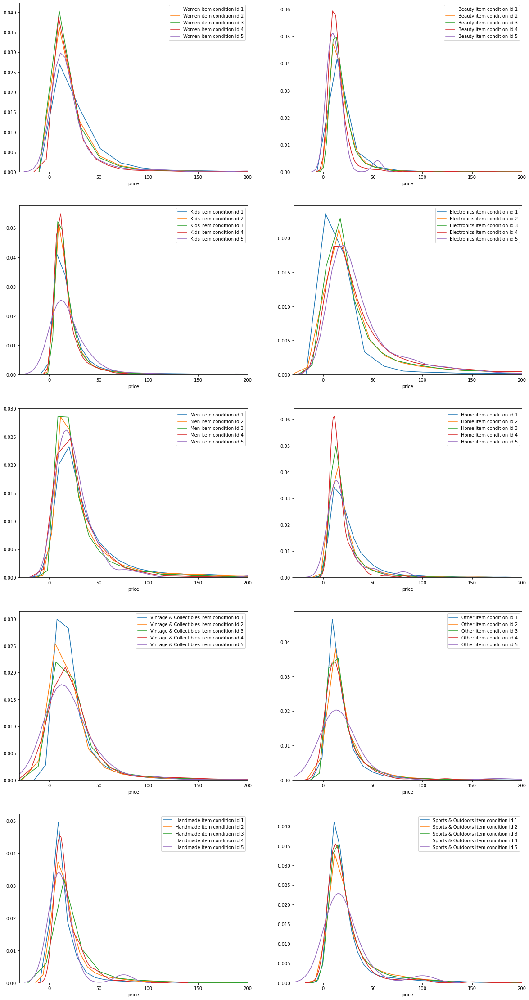

In [35]:
fig,ax=plt.subplots(5,2,figsize=(20,40))
#ax.set_xlim([-30,200]) 
a=0
s=0
for index,i in enumerate(list(df['subcat1'].value_counts().index)):
    #plt.figure(figsize=(20,15))
    for j in [1,2,3,4,5]:
        #print(s,a)
        g=sns.distplot(df[(df['subcat1']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)),ax=ax[s][a])
        g.set(xlim=(-30,200))
    #plt.xlim(-30,200)    
    #plt.show() 
    a+=1
    if a==2:
        s+=1
        a=0

this plot shows the price range and distribution with respect to subcat1 and condition both.
for example--subcategory women with condition 1,2,3,4,5 have price distribution which is shown there. from this plot we can see that all subcategories1 with all condition have almost same distribution of price.

## subcat2

<h1 style='color:red'>plot 16</h1>

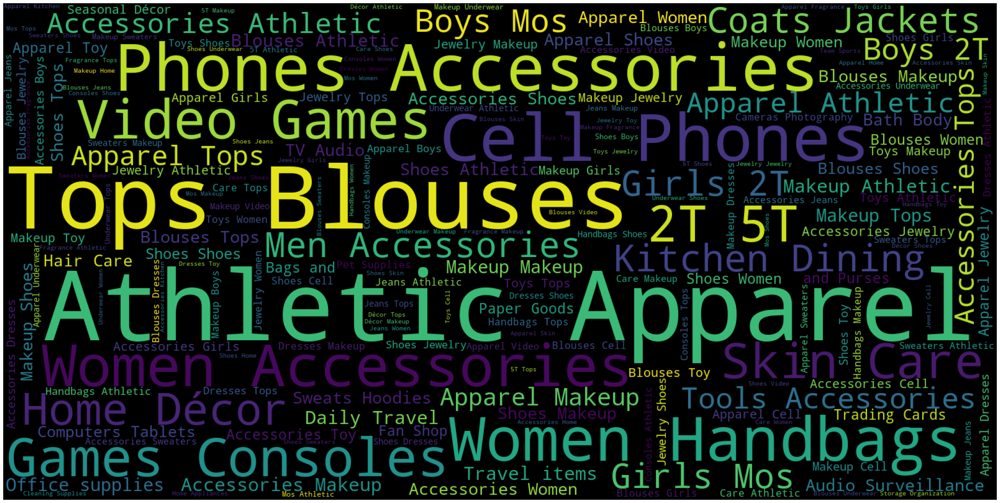

In [228]:
# plotting_wordcloud('category_name')
sentences=''
for i in df['subcat2'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

<h1 style='color:red'>plot 17</h1>

(0.0, 100.0)

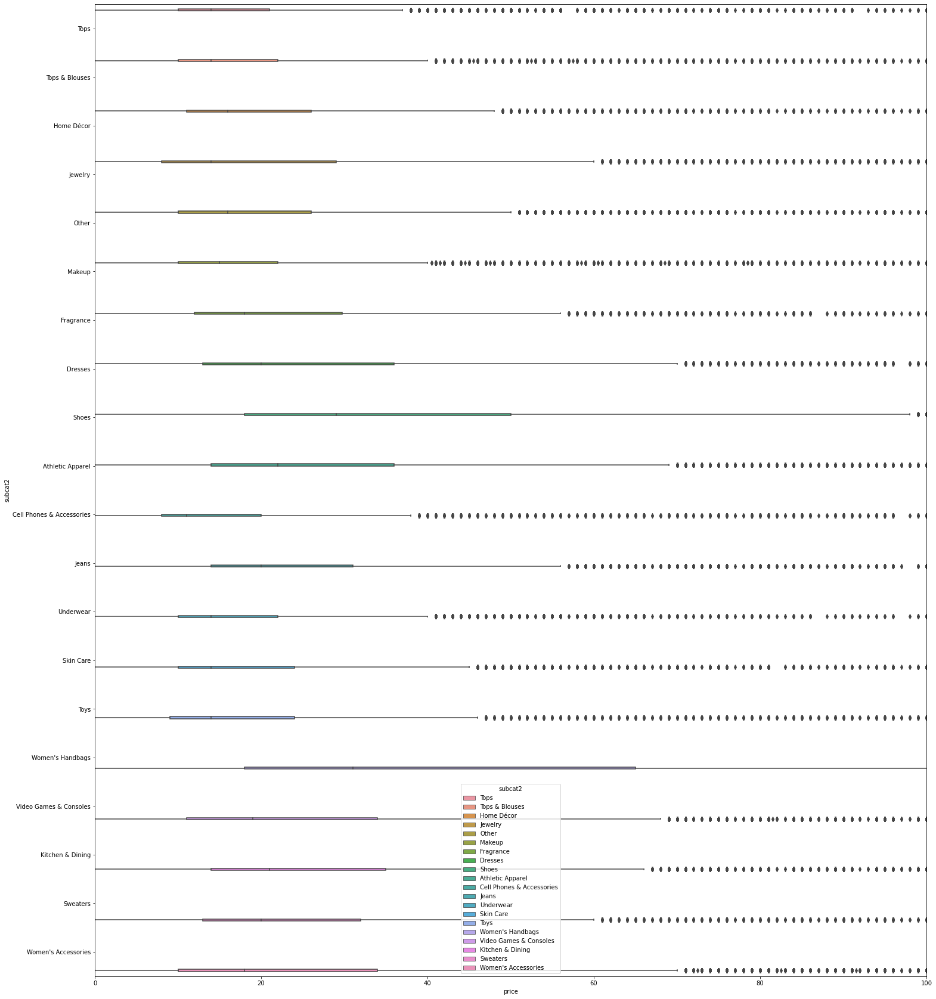

In [36]:
plt.figure(figsize=(25,30))
df_subcat2 = df[df['subcat2'].isin(list(df['subcat2'].value_counts()[0:20].index))]
# df_subcat2 = df[(df['subcat2']=='Athletic Apparel') | (df['subcat2']=='Makeup') | (df['subcat2']=='Tops & Blouses') | (df['subcat2']=='Shoes') | (df['subcat2']=='Jewelry')]
sns.boxplot(x=df_subcat2['price'],y=df_subcat2['subcat2'],hue=df_subcat2['subcat2'],orient='h')
plt.xlim(0,100)

here i am plotting the distribution of price regarding top 20 occured subcat_2. there are some subcat_2 which have large range of price and other one have almost same range of price.

<h1 style='color:red'>plot 18</h1>

(-30.0, 250.0)

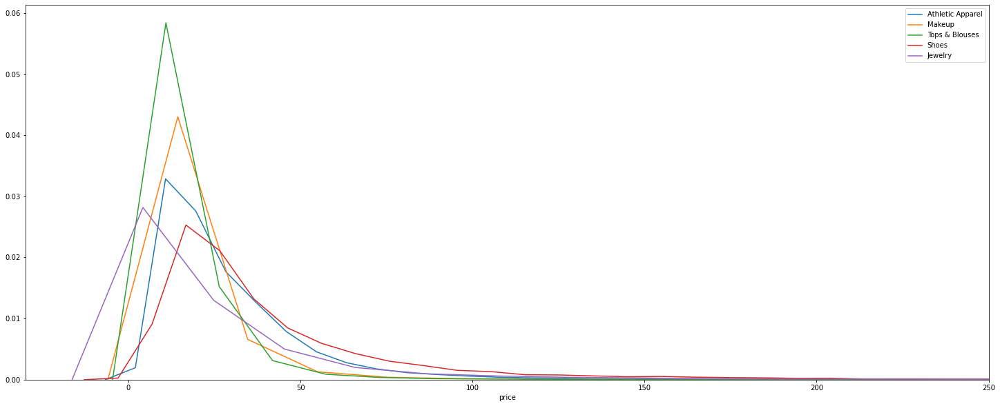

In [37]:
plt.figure(figsize=(25,10))
for i in list(df['subcat2'].value_counts()[0:5].index):
    sns.distplot(df[df['subcat2']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,250)    

here i have plotted top 5 occured subcat2's price distributions and all are little bit different from each other.

<h1 style='color:red'>plot 19</h1>

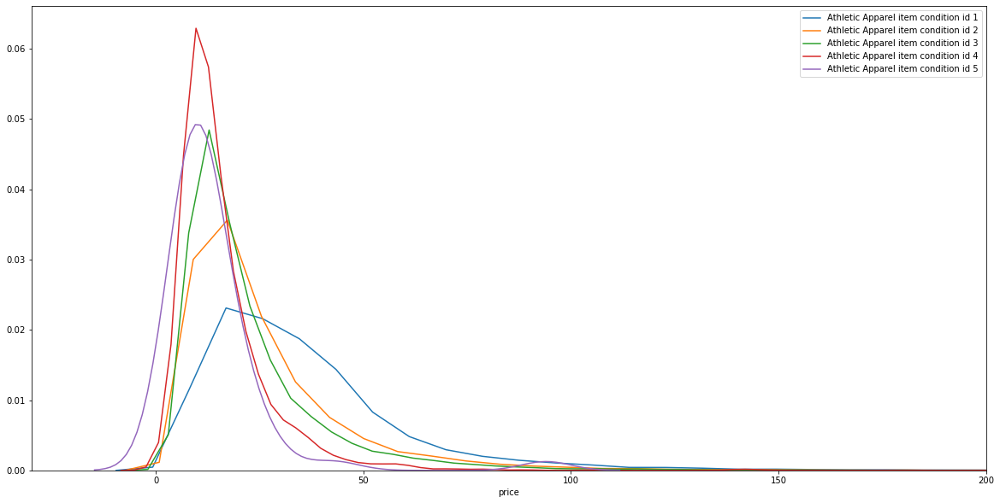

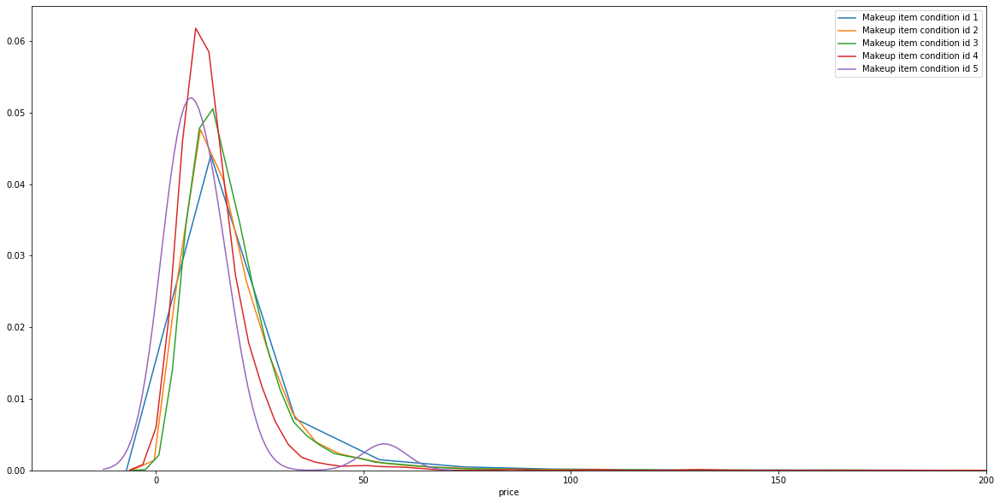

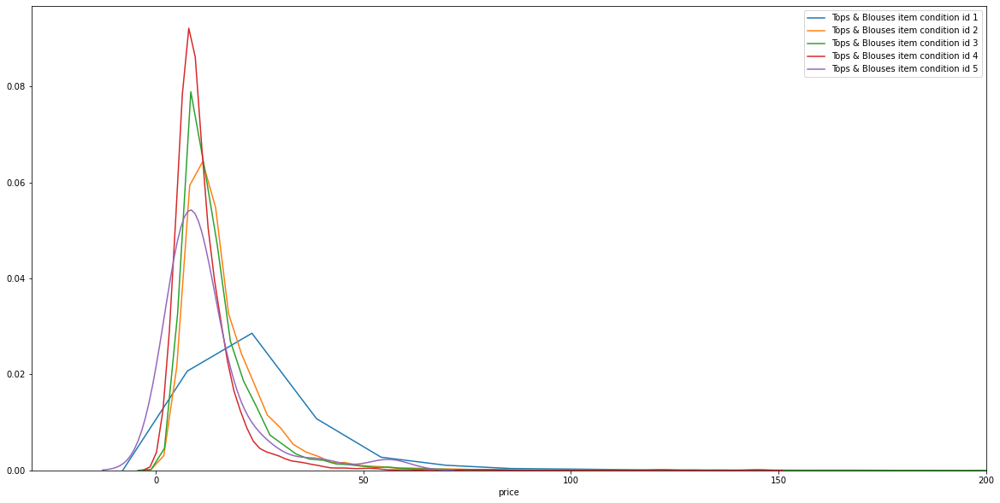

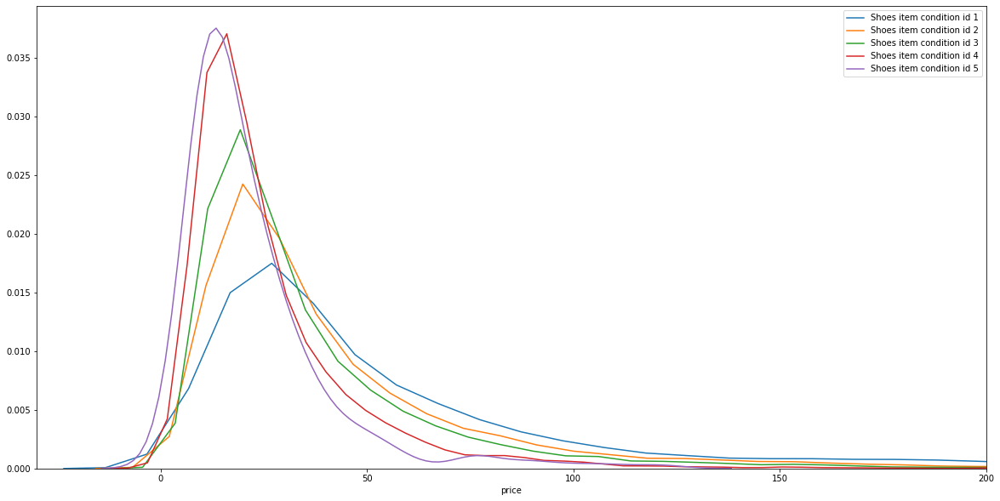

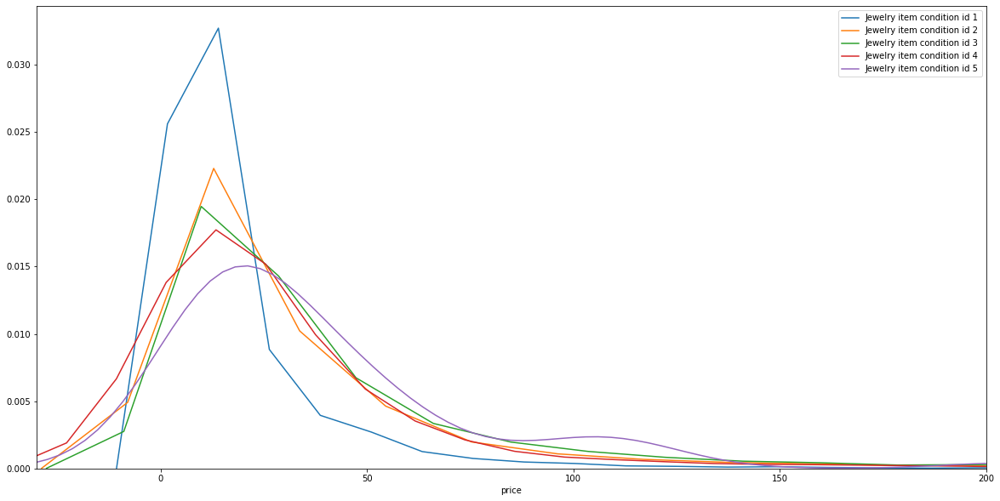

In [38]:
for index,i in enumerate(list(df['subcat2'].value_counts()[0:5].index)):
    plt.figure(figsize=(20,10))
    for j in [1,2,3,4,5]:
        sns.distplot(df[(df['subcat2']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)))
    plt.xlim(-30,200)    
    plt.show() 

here i have taken top 5 subcat2 and on each subcat2 we are taking condition_id and plotting distribution plot.for shoes and jewelry each condition_id have some different distribution of prices.

## subcat3

<h1 style='color:red'>plot 20</h1>

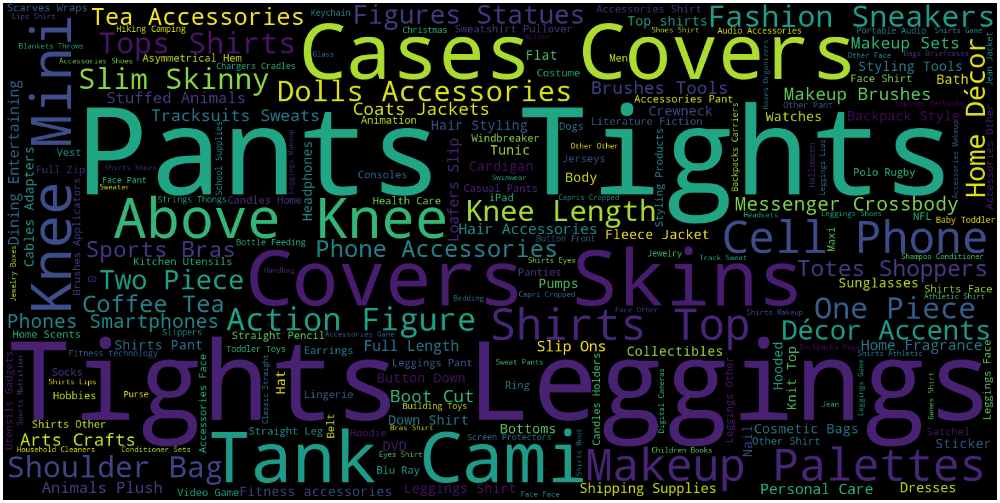

In [229]:
# plotting_wordcloud('category_name')
sentences=''
for i in df['subcat3'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

In [39]:
df['subcat3'].value_counts()

Pants, Tights, Leggings    60177
Other                      50224
Face                       50171
T-Shirts                   46380
Shoes                      32168
                           ...  
Nursery Furniture              1
St Patricks                    1
Frames                         1
Bathroom                       1
Garbage Disposals              1
Name: subcat3, Length: 870, dtype: int64

<h1 style='color:red'>plot 21</h1>

(0.0, 100.0)

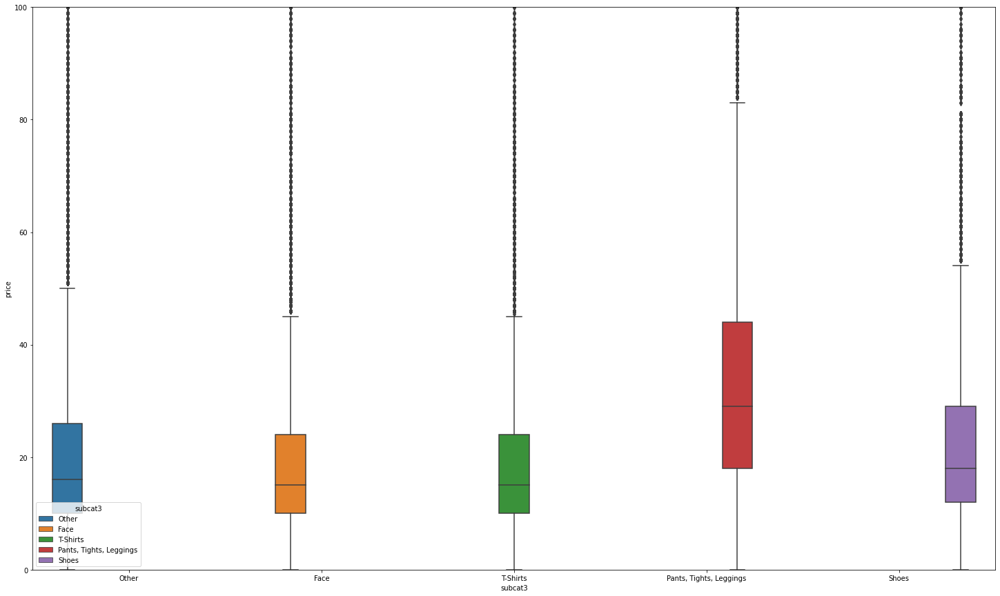

In [40]:
plt.figure(figsize=(25,15))
df_subcat3 = df[(df['subcat3']=='Pants, Tights, Leggings') | (df['subcat3']=='Other') | (df['subcat3']=='Face') | (df['subcat3']=='T-Shirts') | (df['subcat3']=='Shoes')]
sns.boxplot(x=df_subcat3['subcat3'],y=df_subcat3['price'],hue=df_subcat3['subcat3'])
plt.ylim(0,100)

here i am plotting box plot of top 5 occuring subcat3 and we can see that the pants,tights,leggings price distributions are different from other subcat3 distribution of prices.

<h1 style='color:red'>plot 22</h1>

(-30.0, 150.0)

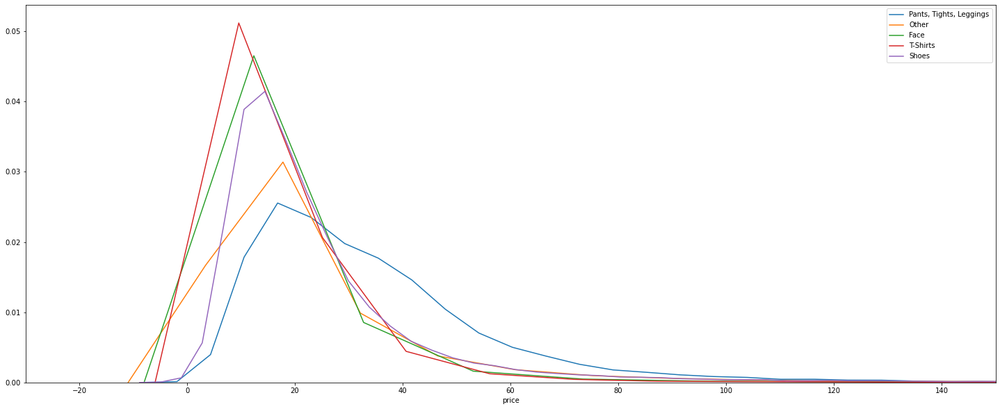

In [41]:
plt.figure(figsize=(25,10))
for i in list(df['subcat3'].value_counts()[0:5].index):
    sns.distplot(df[df['subcat3']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,150) 

here also we can see that the distribution of pants,tights,leggings is different from all other distributions.

<h1 style='color:red'>plot 23</h1>

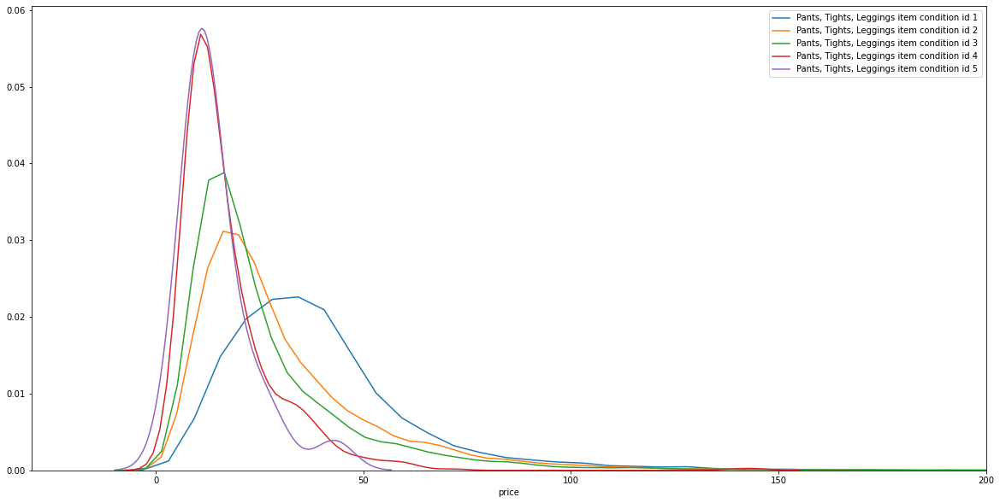

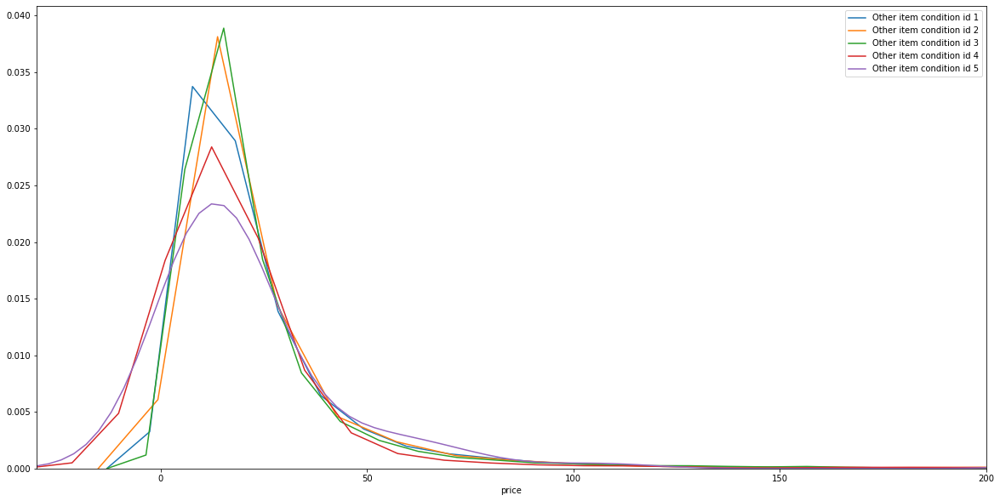

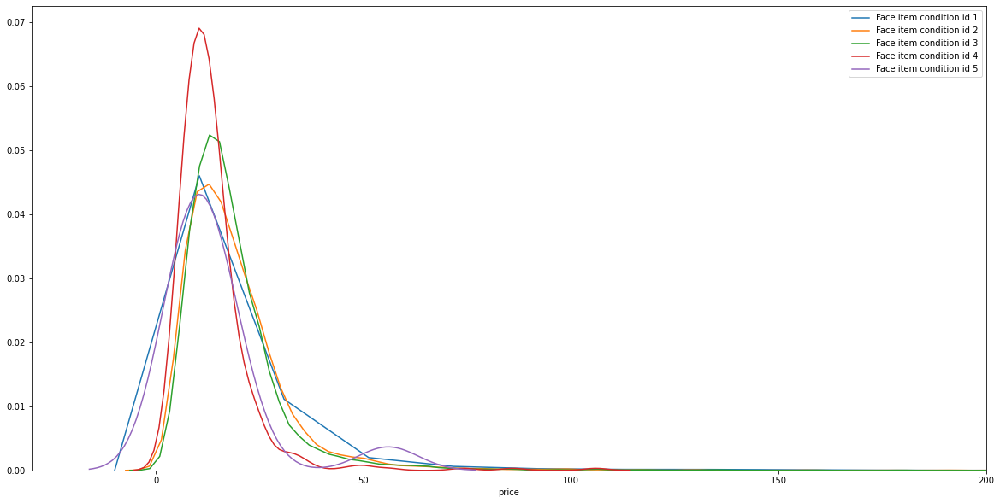

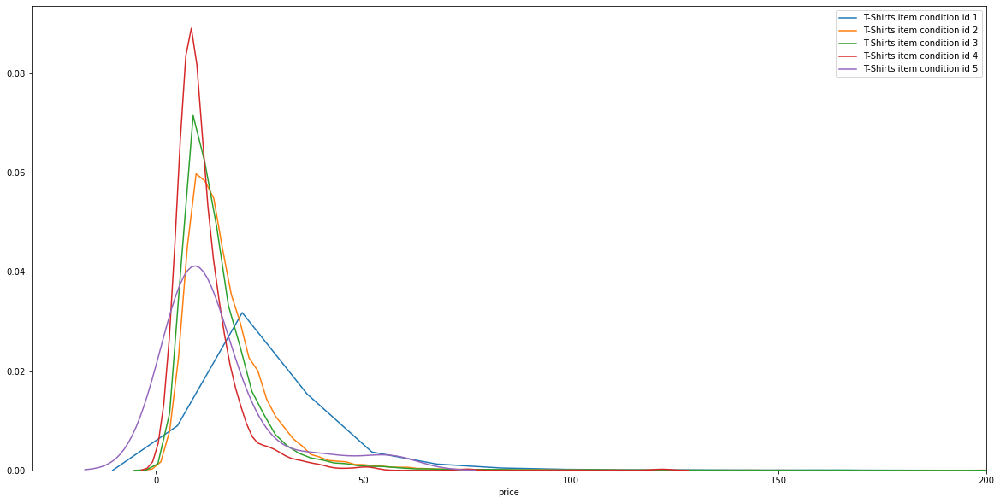

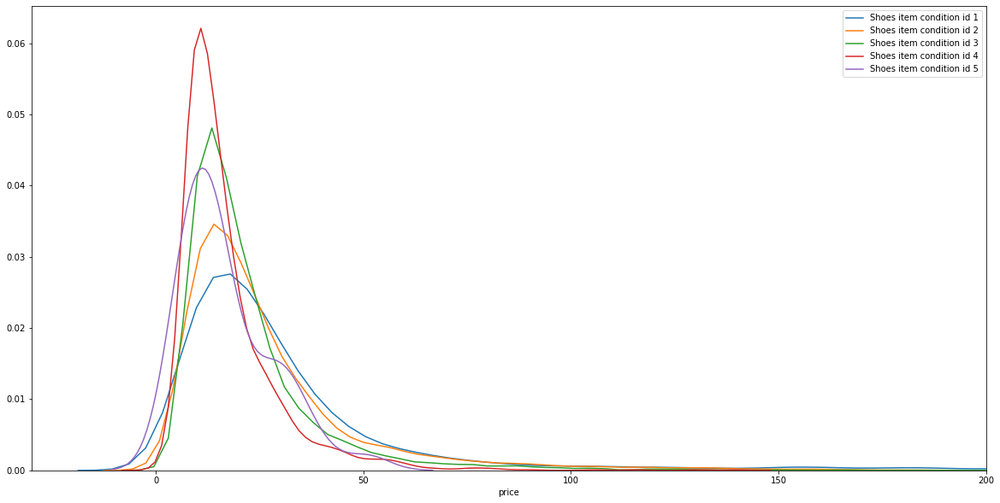

In [42]:
for index,i in enumerate(list(df['subcat3'].value_counts()[0:5].index)):
    plt.figure(figsize=(20,10))
    for j in [1,2,3,4,5]:
        sns.distplot(df[(df['subcat3']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)))
    plt.xlim(-30,200)    
    plt.show() 

the price distributions of pants,tights,leggings on each conditions_id are different. and all other are almost same.

## subcat4

<h1 style='color:red'>plot 24</h1>

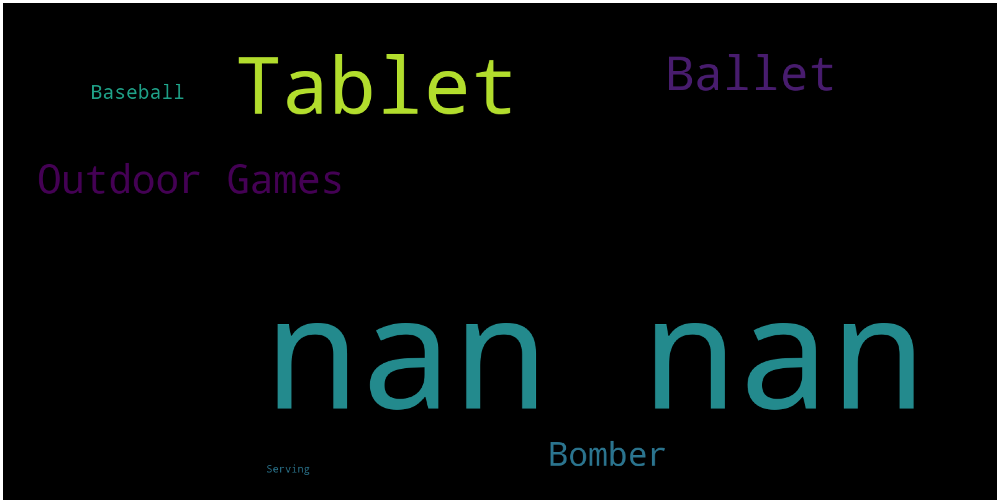

In [288]:
sentences=''
for i in df['subcat4'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

In [43]:
df['subcat4'].value_counts()

Tablet           3059
Ballet            598
Outdoor Games     413
Bomber            273
Baseball           44
Serving             2
Name: subcat4, dtype: int64

<h1 style='color:red'>plot 25</h1>

(0.0, 100.0)

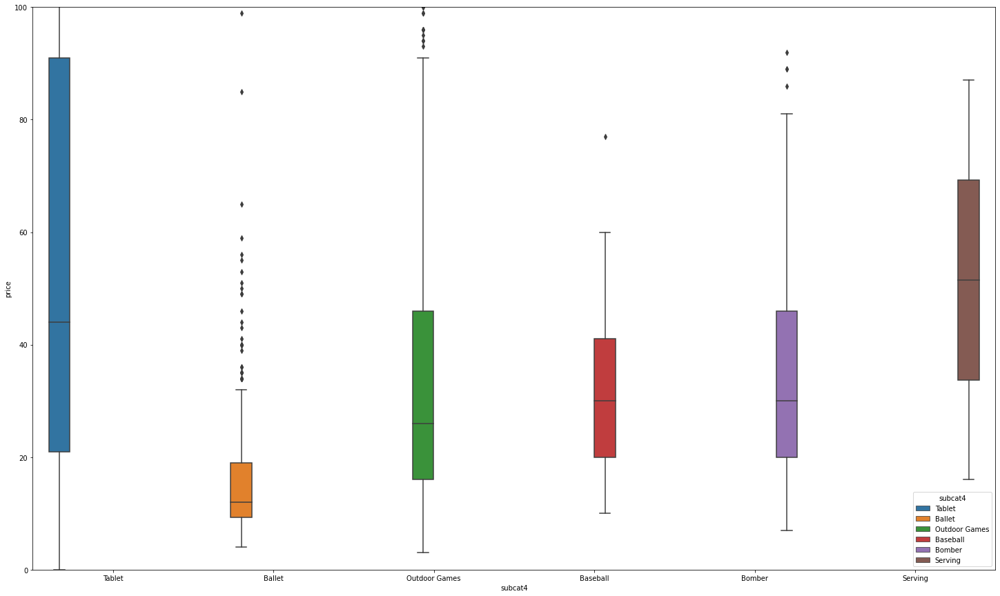

In [44]:
plt.figure(figsize=(25,15))
# df_subcat3 = df[(df['subcat3']=='Pants, Tights, Leggings') | (df['subcat3']=='Other') | (df['subcat3']=='Face') | (df['subcat3']=='T-Shirts') | (df['subcat3']=='Shoes')]
sns.boxplot(x=df['subcat4'],y=df['price'],hue=df['subcat4'])
plt.ylim(0,100)

in above box plot we can see that the price distribution of ballet and serving are totally different and the price distribution of nan(where no subcat4 is given) and serving are also different.the subcat4 tablet has wide range of price.

<h1 style='color:red'>plot 26</h1>

(-30.0, 250.0)

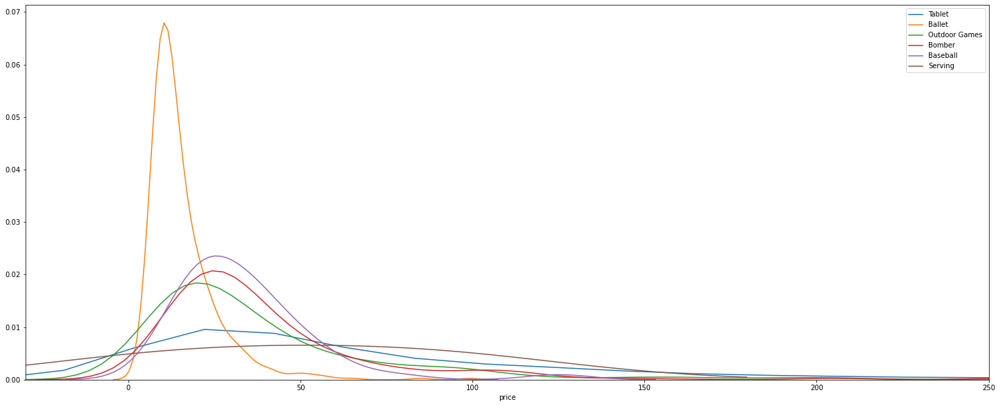

In [45]:
plt.figure(figsize=(25,10))
for i in list(df['subcat4'].value_counts().index):
    sns.distplot(df[df['subcat4']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,250)

from above dist plot we can see that ballet have more low prices where as all other 4 subcat4 have some large prices.

<h1 style='color:red'>plot 27</h1>

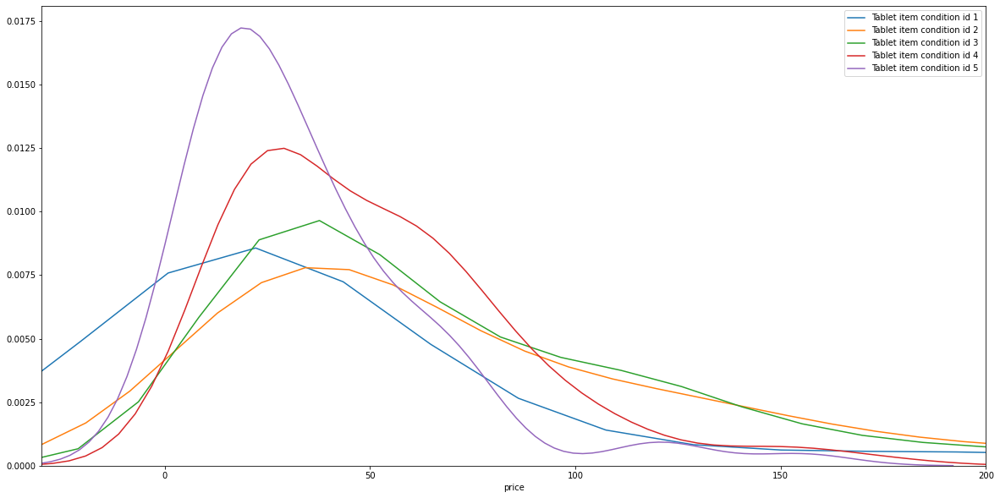

C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


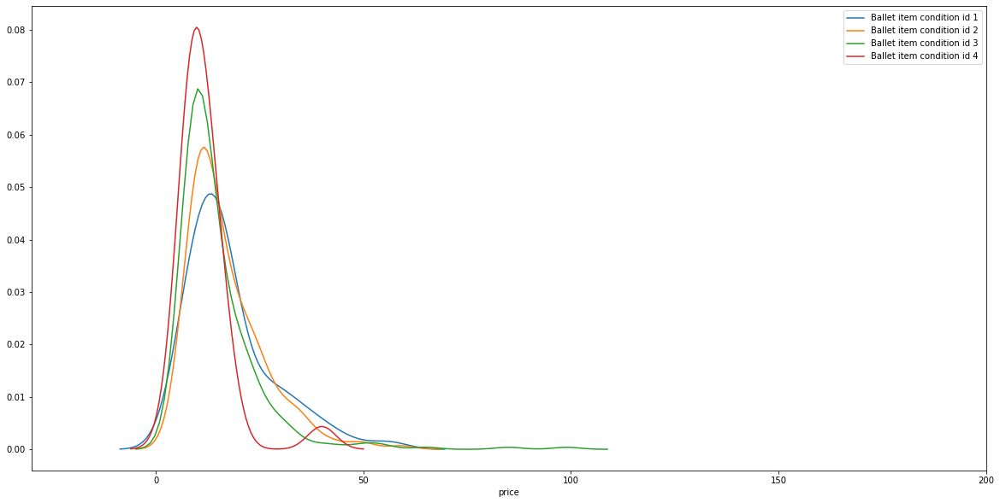

C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


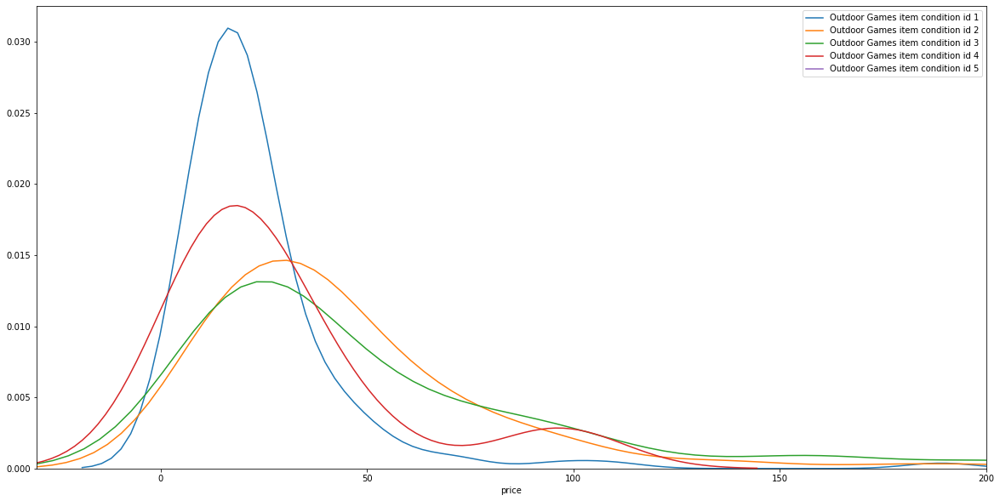

C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


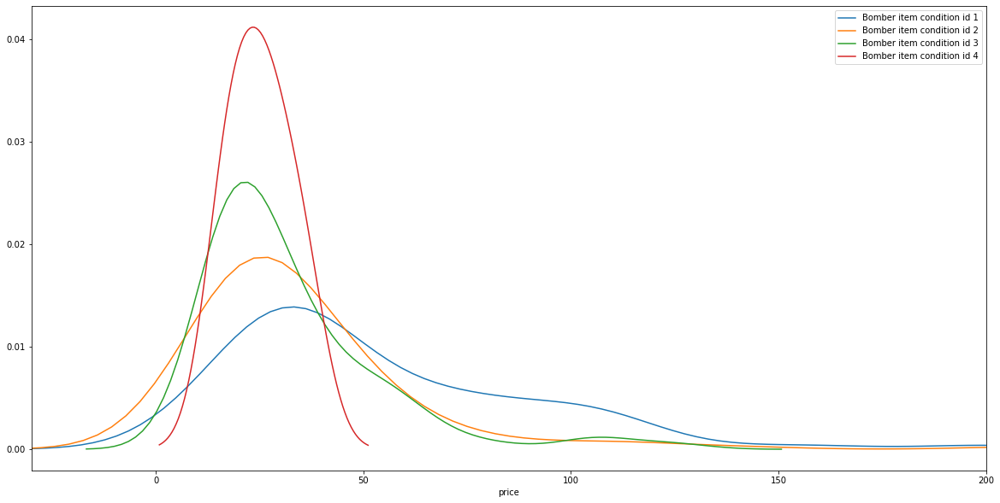

C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


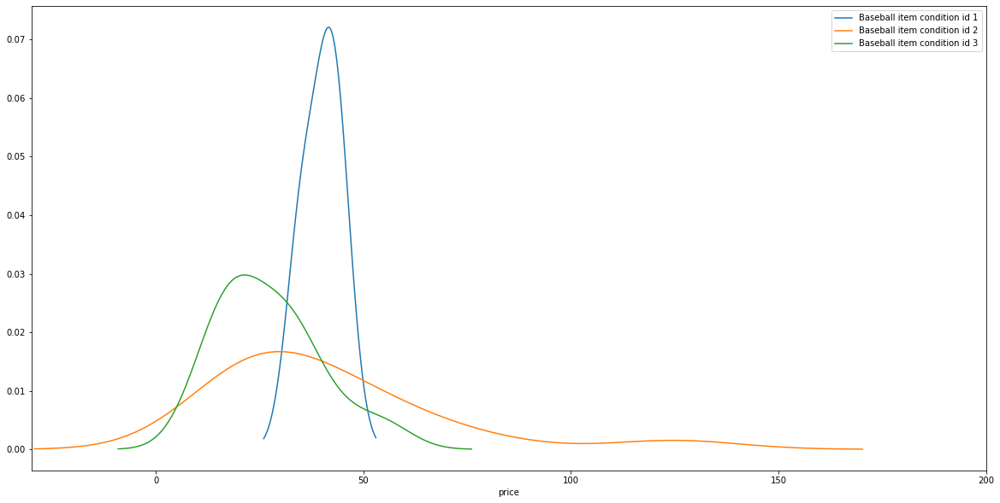

C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Users\vishw\anaconda3\envs\tf-gpu-1\lib\site-packages\numpy\core\_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret

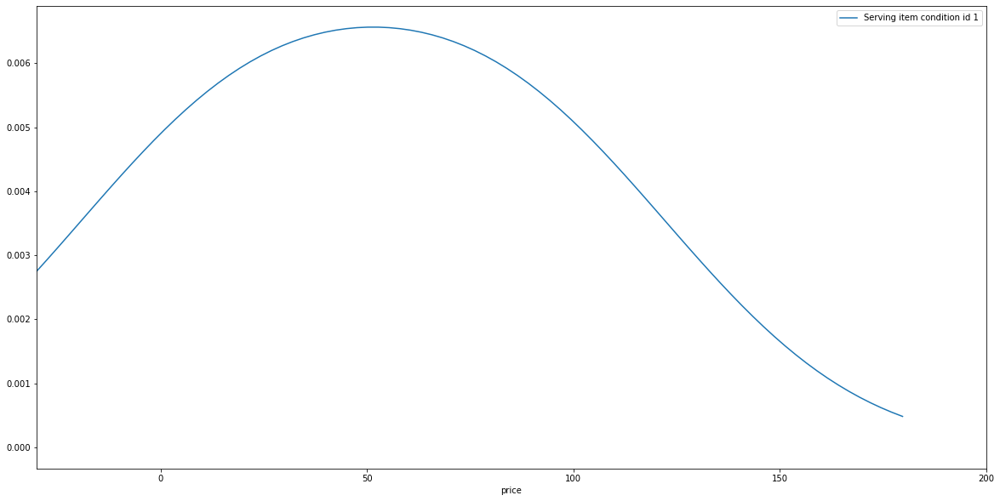

In [46]:
for index,i in enumerate(list(df['subcat4'].value_counts().index)):
    plt.figure(figsize=(20,10))
    for j in [1,2,3,4,5]:
        sns.distplot(df[(df['subcat4']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)))
    plt.xlim(-30,200)    
    plt.show()

## subcat5

In [47]:
df['subcat5'].value_counts()

eBook Readers    1986
eBook Access     1073
Name: subcat5, dtype: int64

<h1 style='color:red'>plot 28</h1>

(0.0, 100.0)

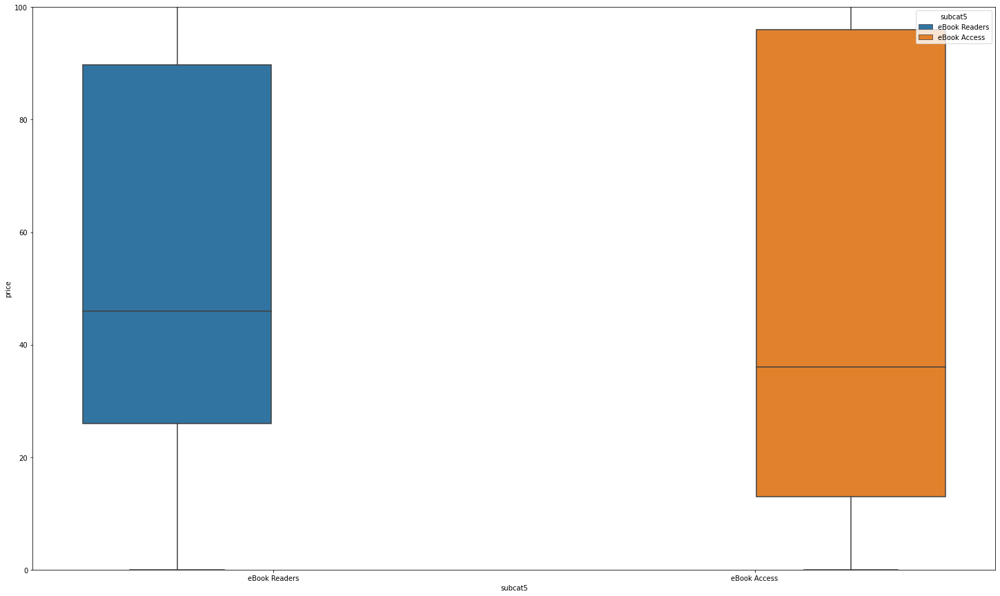

In [48]:
plt.figure(figsize=(25,15))
# df_subcat3 = df[(df['subcat3']=='Pants, Tights, Leggings') | (df['subcat3']=='Other') | (df['subcat3']=='Face') | (df['subcat3']=='T-Shirts') | (df['subcat3']=='Shoes')]
sns.boxplot(x=df['subcat5'],y=df['price'],hue=df['subcat5'])
plt.ylim(0,100)

price range of nan subcat5 is different from other two subcat5.
nan has low prices(where we have no subcat5 the price is low) but where we have some subcat5 the price is low also and high also.

<h1 style='color:red'>plot 29</h1>

(-30.0, 250.0)

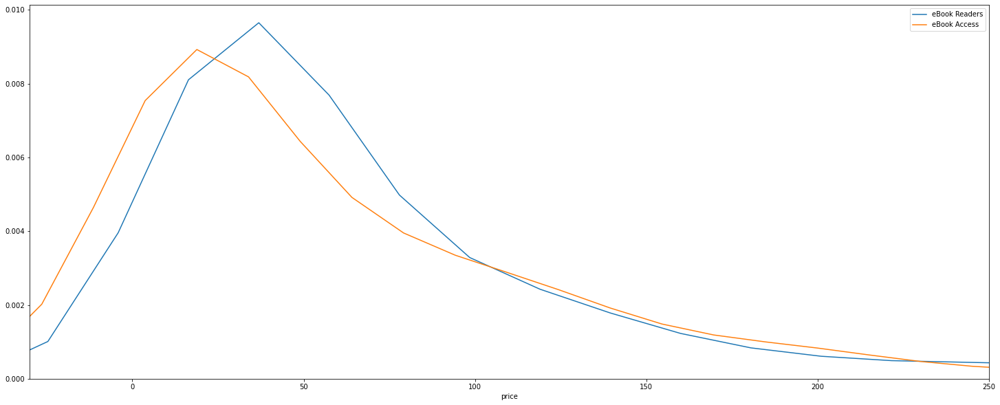

In [49]:
plt.figure(figsize=(25,10))
for i in list(df['subcat5'].value_counts().index):
    sns.distplot(df[df['subcat5']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,250)

<h1 style='color:red'>plot 30</h1>

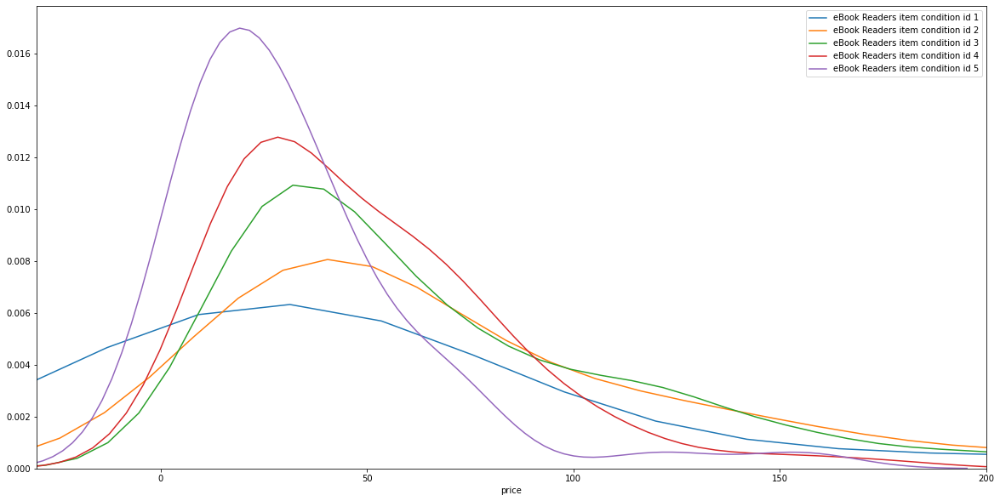

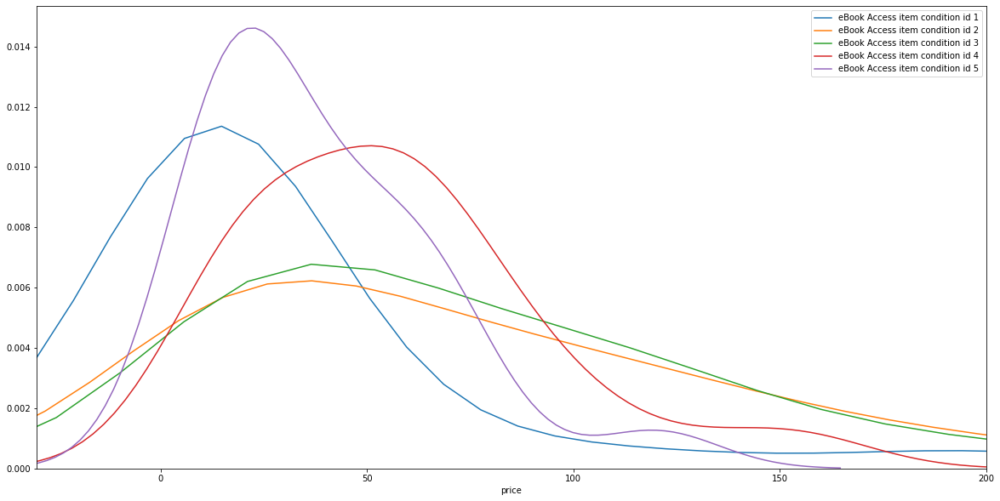

In [50]:
for index,i in enumerate(list(df['subcat5'].value_counts().index)):
    plt.figure(figsize=(20,10))
    for j in [1,2,3,4,5]:
        sns.distplot(df[(df['subcat5']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)))
    plt.xlim(-30,200)    
    plt.show()

both subcat5(ebook access and ebook readers) with each condition_id have different distributions of prices.

<h1 style='color:red'>plot 31</h1>

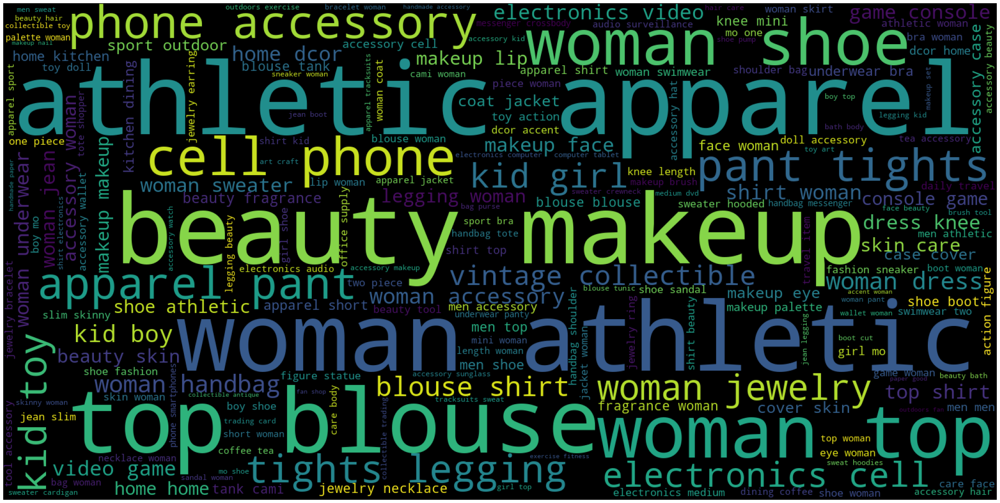

In [106]:
sentences=''
for i in df[df['price']<=100]['category_name'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

<h1 style='color:red'>plot 32</h1>

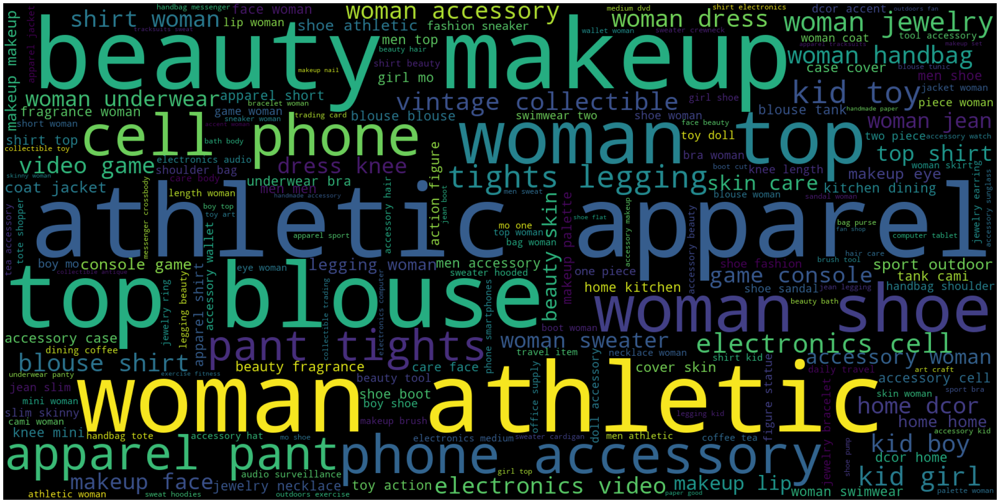

In [107]:
sentences=''
for i in df[df['price']<=10]['category_name'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

in the above wordcloud we can see that the categories like women athletic, beauty makeup, athletic apparel etc appears in most of the datapoints.

In [51]:
each_sentence_word=[]
for i in df['category_name'].values:
    each_sentence_word.append(len(i.split()))

<h1 style='color:red'>plot 33</h1>

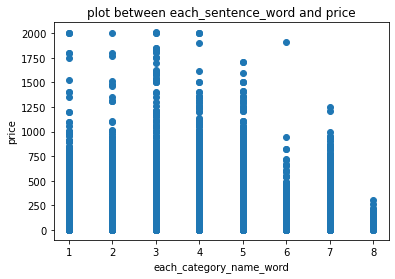

In [52]:
plt.scatter(each_sentence_word,df['price'])
plt.title('plot between each_sentence_word and price')
plt.xlabel('each_category_name_word')
plt.ylabel('price')
plt.show()

In [53]:
sc.stats.spearmanr(each_sentence_word,df['price'])

SpearmanrResult(correlation=0.01084759590024094, pvalue=1.1419431879248294e-39)

but the correlation between number f categories and price is very low.

# brand_name EDA
this column have some null values

In [54]:
df['brand_name'].isnull().sum()

0

In [55]:
df.shape

(1476208, 15)

42% of the rows dont have brand name.

we have 14,82,535 data but the brand_name is not present for the 6,32,682 rows

total brand we have is 4810.

In [56]:
df['brand_name'].unique().shape

(4792,)

In [57]:
df['brand_name'].value_counts()

nan                     629225
nike                     53960
pink                     53930
victoria's secret        47935
lularoe                  30873
                         ...  
scunci                       1
osprey                       1
jones sport                  1
costume super center         1
electronic arts              1
Name: brand_name, Length: 4792, dtype: int64

In [58]:
# here we are counting each brands frequency in our data
df_brand_name=pd.DataFrame(df['brand_name'].value_counts())

here we are doing analysis on how many times each brand presented in data.

In [59]:

# for i in range(0,100,10):
#     var =df_brand_name["brand_name"].values
#     var = np.sort(var,axis = None)
#     print("{} percentile value is {}".format(i,var[int(len(var)*(float(i)/100))]),'means {}% brands are in only {} row in data'.format(i,var[int(len(var)*(float(i)/100))]))
# print ("100 percentile value is ",var[-1])

In [60]:
# for i in range(90,100,1):
#     var =df_brand_name["brand_name"].values
#     var = np.sort(var,axis = None)
#     print("{} percentile value is {}".format(i,var[int(len(var)*(float(i)/100))]),'means {}% brands are in only {} row'.format(i,var[int(len(var)*(float(i)/100))]))
# print ("100 percentile value is ",var[-1])

here we check if any rows have two brands

In [61]:
no_rows_with_2_br=0
rows=set()
for i in df['brand_name'].values:
    if len(str(i).split(','))>1:
        no_rows_with_2_br+=1
        rows.add(i)
print('the number of rows which have two brands',no_rows_with_2_br)        

the number of rows which have two brands 97


In [62]:
(rows)

{'avon cosmetics, inc',
 'coty, inc.',
 'express, inc.',
 'patagonia, inc.',
 'rocky brands, inc.',
 'ulta salon, cosmetics & fragrance, inc.'}

from the analysis it's clear that there are six brand_name with comma seperated like 'Ulta Salon, Cosmetics & Fragrance, Inc.' and 'Patagonia, Inc.', but i think these are the single names.

In [63]:
df['brand_name'].value_counts()

nan                     629225
nike                     53960
pink                     53930
victoria's secret        47935
lularoe                  30873
                         ...  
scunci                       1
osprey                       1
jones sport                  1
costume super center         1
electronic arts              1
Name: brand_name, Length: 4792, dtype: int64

<h1 style='color:red'>plot 34</h1>

(0.0, 100.0)

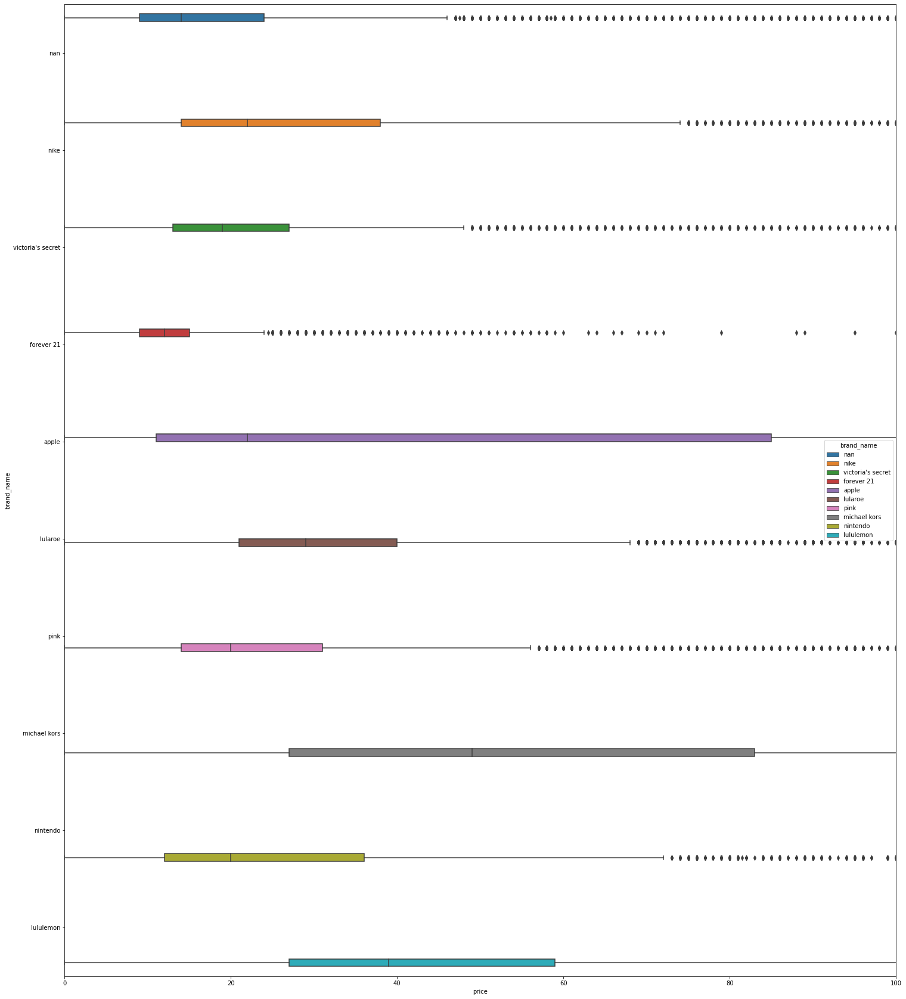

In [64]:
plt.figure(figsize=(25,30))
df_brand = df[df['brand_name'].isin(list(df['brand_name'].value_counts()[0:10].index))]
# df_subcat2 = df[(df['subcat2']=='Athletic Apparel') | (df['subcat2']=='Makeup') | (df['subcat2']=='Tops & Blouses') | (df['subcat2']=='Shoes') | (df['subcat2']=='Jewelry')]
sns.boxplot(x=df_brand['price'],y=df_brand['brand_name'],hue=df_brand['brand_name'],orient='h')
plt.xlim(0,100)

top 10 occuring brands name's price ranges are quite different see lot's of boxes are not overlapping.

<h1 style='color:red'>plot 35</h1>

(-30.0, 150.0)

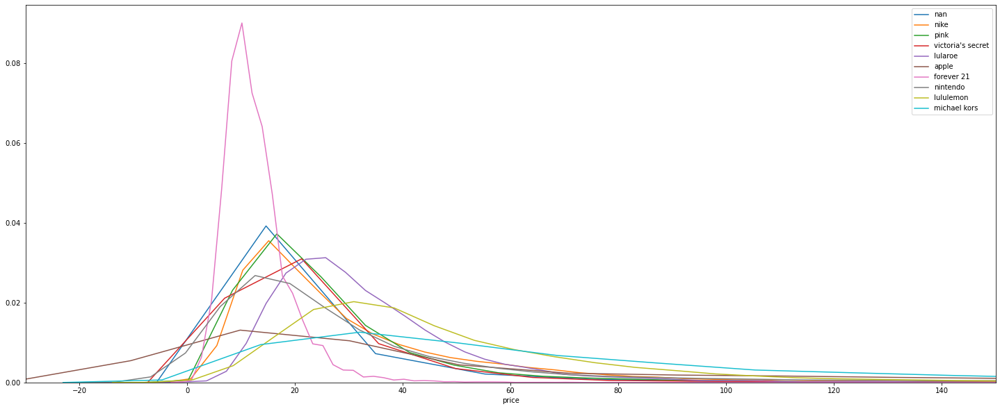

In [65]:
plt.figure(figsize=(25,10))
for i in list(df['brand_name'].value_counts()[0:10].index):
    sns.distplot(df[df['brand_name']==i]['price'],hist=False,label=i)
plt.legend()    
plt.xlim(-30,150)

<h1 style='color:red'>plot 36</h1>

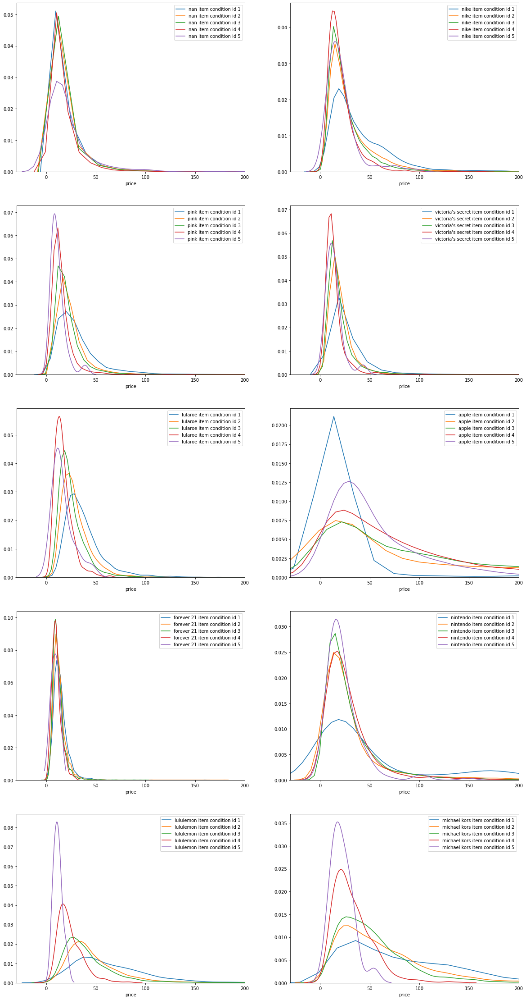

In [66]:
fig,ax=plt.subplots(5,2,figsize=(20,40))
#ax.set_xlim([-30,200]) 
a=0
s=0
for index,i in enumerate(list(df['brand_name'].value_counts()[0:10].index)):
    #plt.figure(figsize=(20,15))
    for j in [1,2,3,4,5]:
        g=sns.distplot(df[(df['brand_name']==i) & (df['item_condition_id']==j)]['price'],hist=False,label=str(str(i)+' item condition id '+str(j)),ax=ax[s][a])
        g.set(xlim=(-30,200))
    a+=1
    if a==2:
        s+=1
        a=0

top 10 brands name with each condition_id price distribution are shown above.the lululemon and michael kors with each conditon_id prices distribution have some difference.

<h1 style='color:red'>plot 37</h1>

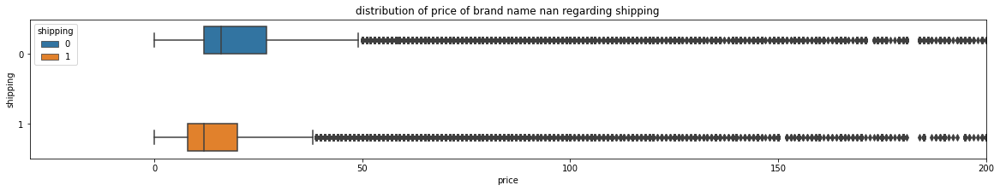

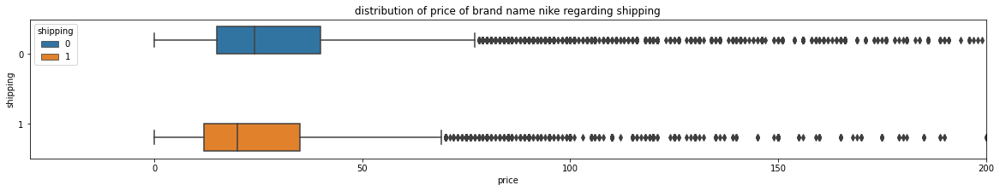

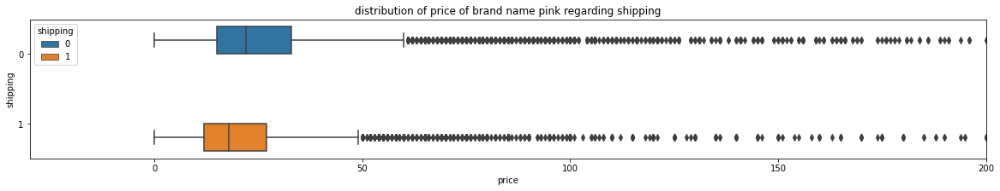

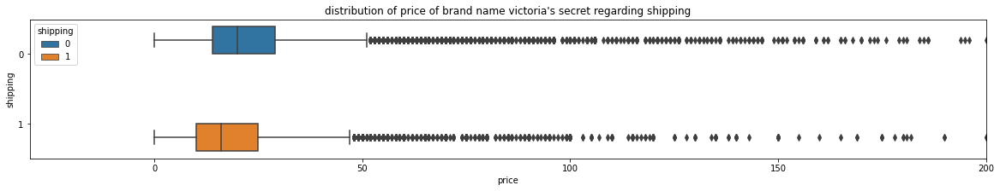

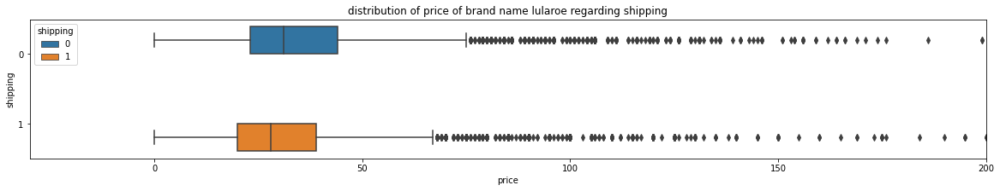

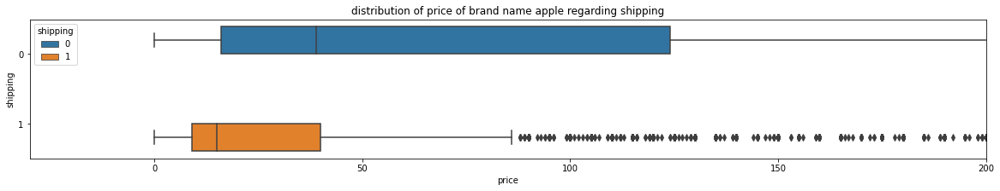

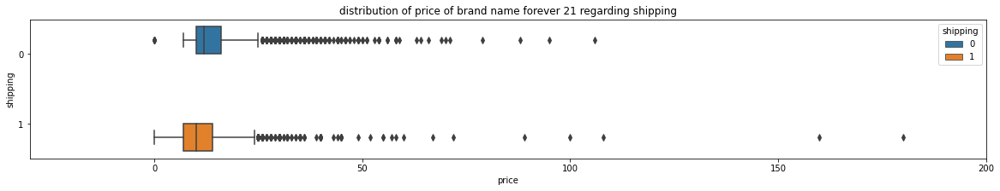

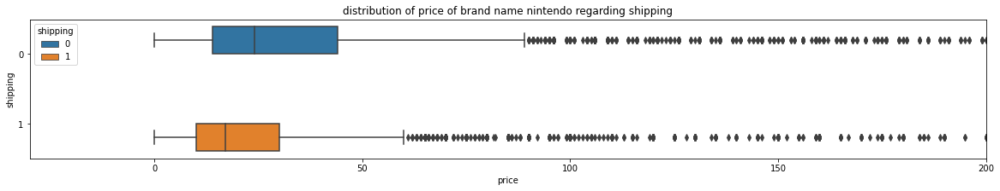

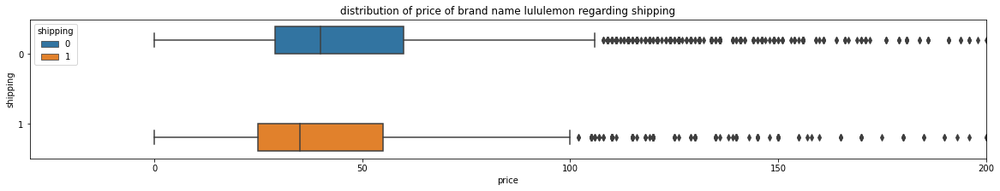

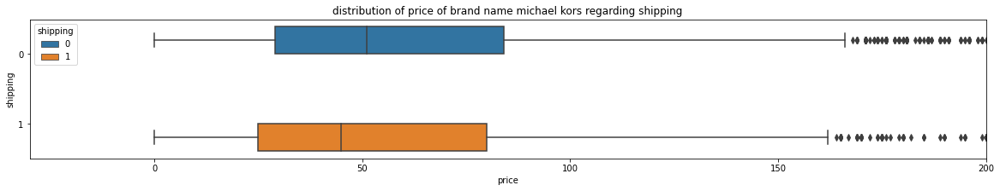

In [67]:
for index,i in enumerate(list(df['brand_name'].value_counts()[0:10].index)):
    plt.figure(figsize=(20,3))
    #for j in [0,1]:
    sns.boxplot(x=df[df['brand_name']==i]['price'],y=df[df['brand_name']==i]['shipping'],hue=df[df['brand_name']==i]['shipping'],orient='h')
    plt.title('distribution of price of brand name '+i+' regarding shipping')
    plt.xlim(-30,200)    
    plt.show()

i can see here each blue box is little bit ahead of each orange box means that when shipping fee is paid by buyer then the price is high.
if we see then the american eagle brand name with each shipping(0 and 1) have different price range from michael kors and lululemon price range.
and we can see more such relations.

<h1 style='color:red'>plot 38</h1>

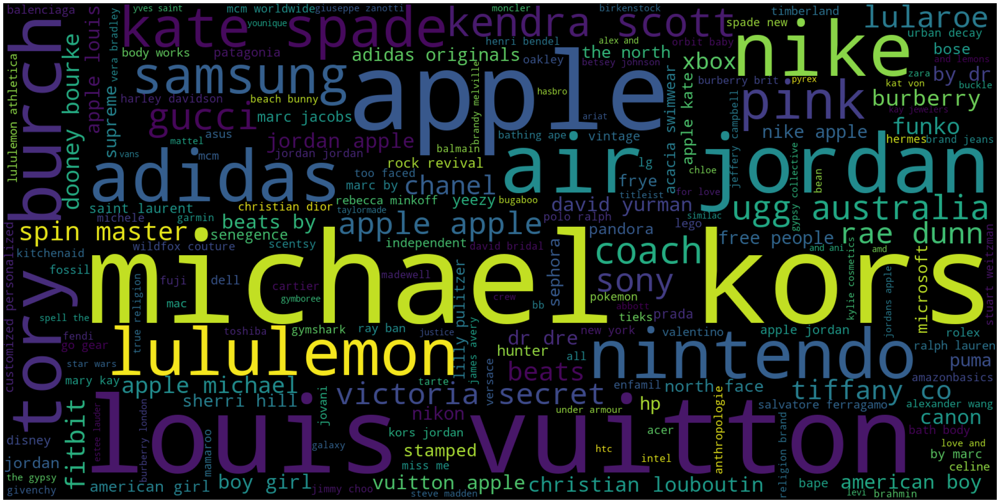

In [122]:
sentences=''
for i in df[df['price']>=100]['brand_name'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

<h1 style='color:red'>plot 39</h1>

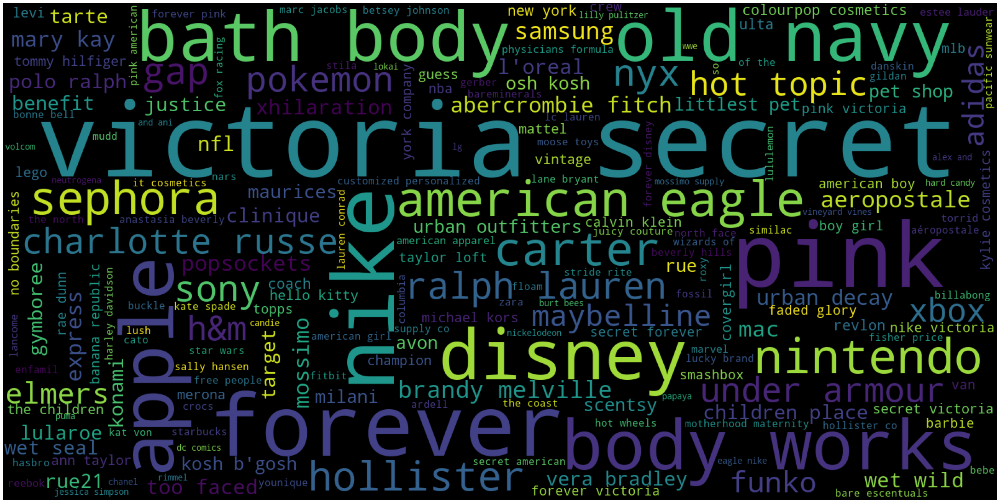

In [127]:
sentences=''
for i in df[df['price']<=10]['brand_name'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

In [68]:
df.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,category_name_len,subcat1,subcat2,subcat3,subcat4,subcat5,name_each_sen_word
0,0,mlb cincinnati red shirt size,3,Men/Tops/T-shirts,nan,10.0,1,description_yet,3,Men,Tops,T-shirts,NaN,NaN,5
1,1,razer blackwidow chroma keyboard,3,Electronics/Computers & Tablets/Components & P...,razer,52.0,0,keyboard great condition work like came box po...,3,Electronics,Computers & Tablets,Components & Parts,NaN,NaN,4
2,2,ava viv blouse,1,Women/Tops & Blouses/Blouse,target,10.0,1,adorable top hint lace key hole back pale pink...,3,Women,Tops & Blouses,Blouse,NaN,NaN,3
3,3,leather horse statue,1,Home/Home Décor/Home Décor Accents,nan,35.0,1,new tag leather horse retail stand foot high s...,3,Home,Home Décor,Home Décor Accents,NaN,NaN,3
4,4,k gold plated rose,1,Women/Jewelry/Necklaces,nan,44.0,0,complete certificate authenticity,3,Women,Jewelry,Necklaces,NaN,NaN,4


In [70]:
# df['brand_name']=df['brand_name'].fillna('nan')

In [71]:
df['brand_name'].value_counts()

nan                     629225
nike                     53960
pink                     53930
victoria's secret        47935
lularoe                  30873
                         ...  
scunci                       1
osprey                       1
jones sport                  1
costume super center         1
electronic arts              1
Name: brand_name, Length: 4792, dtype: int64

# shipping EDA

shipping column is avialable for all the data.

In [72]:
df['shipping'].value_counts()

0    815416
1    660792
Name: shipping, dtype: int64

In [73]:
df_shipping=df.groupby('shipping')['price'].agg(['sum','count'])
df_shipping

,sum,count
shipping,,
0,24562857.0,815416
1,14915774.5,660792


In [74]:
np.median(df[df['shipping']==0]['price'])

20.0

In [75]:
np.median(df[df['shipping']==1]['price'])

14.0

In [76]:
df_shipping['avg price_on shipping']=df_shipping['sum']/df_shipping['count']
df_shipping

,sum,count,avg price_on shipping
shipping,,,
0,24562857.0,815416,30.123099
1,14915774.5,660792,22.572571


if shipping fee is pay by seller then the avg product price is low and when shipping fee is paid by buyer then the cost is high, not much difference.

In [77]:
sc.stats.spearmanr(df['shipping'],df['price'])

SpearmanrResult(correlation=-0.2398344272616837, pvalue=0.0)

shipping have some collinearity with price = -0.24

<h1 style='color:red'>plot 40</h1>

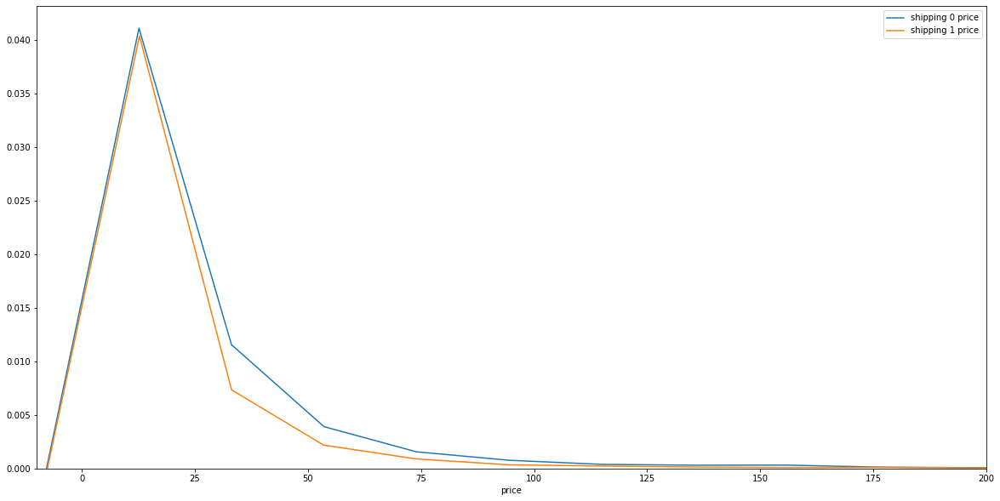

In [78]:
plt.figure(figsize=(20,10))
sns.distplot(df[df['shipping']==0]['price'],hist=False,label='shipping 0 price')
sns.distplot(df[df['shipping']==1]['price'],hist=False,label='shipping 1 price')
plt.legend()
plt.xlim(-10,200)
plt.show()

from above distribution it is clear that when the shipping fee is paid by buyer then the price is little but high. 

# item_description EDA

In [79]:
df['item_description'].value_counts()

description_yet                                                 81880
brand new                                                        5516
new                                                              5439
size                                                             4486
good condition                                                   2834
                                                                ...  
gucci shoulder bag great condition need new home                    1
brandy melville tank condition bnwt size one size rare              1
new pack scotch heavy duty tape price firm                          1
size large girl gymnastic biketard                                  1
vintage windbreaker excellent condition size color beautiful        1
Name: item_description, Length: 1210775, dtype: int64

<p style='color:red'>in above output first line is 'description yet', basically it is 'no description yet' in preprocessing the no word got removed.
so here we have 82,499 rows or data where we have no desription for products.</p>

<h1 style='color:red'>plot 41</h1>

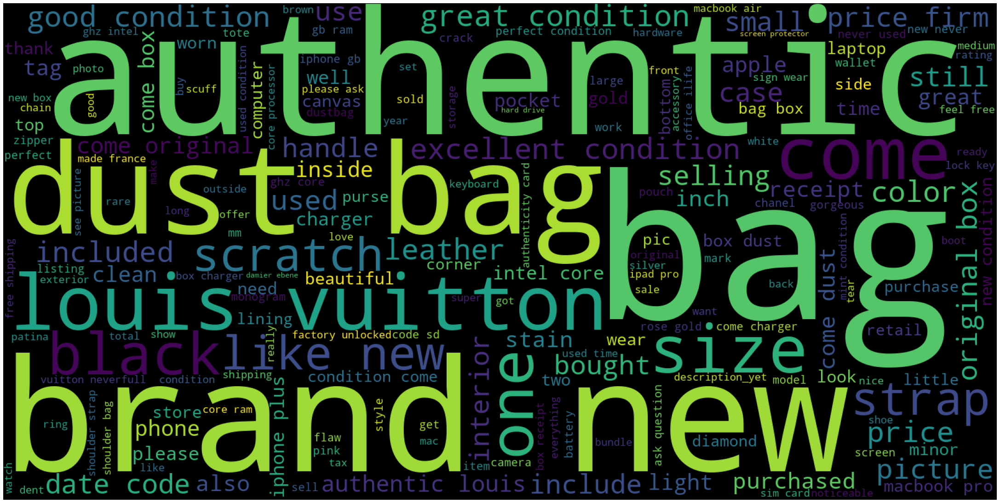

In [131]:
sentences=''
for i in df[df['price']>=500]['item_description'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

in the above worrdcloud description yet and free shipping and brand new are some more frequent words.
here description yet is a frequent so we will see whether we have to remove those rows or keep it.

In [ ]:
sentences=''
for i in df[df['price']<=100]['item_description'].values:
    sentences+=str(i)+' '
# sentences=sentences.strip()    
wordcloud = WordCloud(background_color='black',
                          width=1600,
                          height=800,stopwords=('is','&'),regexp="\w[\w\&']+"
                    ).generate(sentences)

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)

In [80]:
# we are creating list of letter in each item_description.
each_sentence_word=[]
for i in df['item_description'].values:
    each_sentence_word.append(len(i.split()))

<h1 style='color:red'>plot 42</h1>

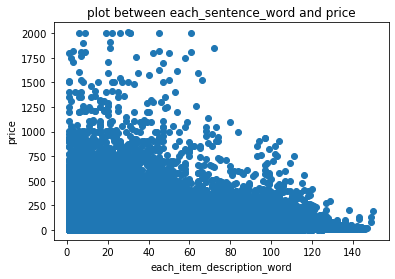

In [81]:
plt.scatter(each_sentence_word,df['price'])
plt.title('plot between each_sentence_word and price')
plt.xlabel('each_item_description_word')
plt.ylabel('price')
plt.show()

when the number of words in each item description is increasing then the price is decreasing.

In [82]:
sc.stats.spearmanr(each_sentence_word,df['price'])

SpearmanrResult(correlation=0.0688897329983846, pvalue=0.0)

the correlation betweeen each_sentence_word and price is almost 0.13.

In [83]:
# we are making list of each sentence in terms of words.
length_of_sentences=[]
for i in df['item_description'].values:
    length_of_sentences.append(len(i))

<h1 style='color:red'>plot 43</h1>

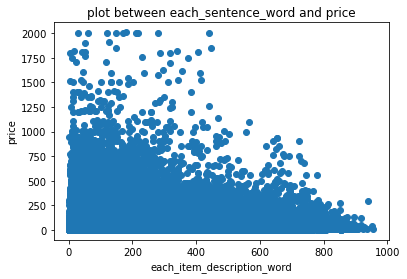

In [84]:
plt.scatter(length_of_sentences,df['price'])
plt.title('plot between each_sentence_word and price')
plt.xlabel('each_item_description_word')
plt.ylabel('price')
plt.show()

this dist plot also shows same thing that we saw before in each_sentence_word

In [85]:
df['item_desc_each_sentence_word']=df['item_description'].apply(lambda x:len(x.split()))

In [86]:
sc.stats.spearmanr(length_of_sentences,df['price'])

SpearmanrResult(correlation=0.06713583141334238, pvalue=0.0)

In [87]:
# # plot dist plot to see price distribution of 'no description yet' and where the description exists.
# sns.distplot(df[(df['item_description']=='description_yet')]['price'],color='red')
# sns.distplot(df[df['item_description']!='description_yet']['price'],color='yellow')
# plt.title('distribution of prices where item_description is "no description yet" and where item_description is available')
# plt.xlabel('prices')
# plt.ylabel('frequency')
# plt.show()

In [88]:
# df['item_description']=df['item_description'].apply(lambda x:'_'.join(x.split()) if x == 'description yet' else x)

In [89]:
df.columns

Index(['train_id', 'name', 'item_condition_id', 'category_name', 'brand_name',
       'price', 'shipping', 'item_description', 'category_name_len', 'subcat1',
       'subcat2', 'subcat3', 'subcat4', 'subcat5', 'name_each_sen_word',
       'item_desc_each_sentence_word'],
      dtype='object')

In [90]:
df['brand_name']=df['brand_name'].apply(lambda x:str(x))
df['subcat1']=df['subcat1'].apply(lambda x:str(x))
df['subcat2']=df['subcat2'].apply(lambda x:str(x))
df['subcat3']=df['subcat3'].apply(lambda x:str(x))
df['subcat4']=df['subcat4'].apply(lambda x:str(x))
df['subcat5']=df['subcat5'].apply(lambda x:str(x))

In [91]:
label_enc=LabelEncoder()
df['subcat1_enc']=label_enc.fit_transform(df['subcat1'].values)
df['subcat2_enc']=label_enc.fit_transform(df['subcat2'].values)
df['subcat3_enc']=label_enc.fit_transform(df['subcat3'].values)
df['subcat4_enc']=label_enc.fit_transform(df['subcat4'].values)
df['subcat5_enc']=label_enc.fit_transform(df['subcat5'].values)
df['brand_name_enc']=label_enc.fit_transform(df['brand_name'].values)

In [92]:
list_col=['item_condition_id','subcat1_enc','subcat2_enc','subcat3_enc','subcat4_enc','subcat5_enc','brand_name_enc','shipping','item_desc_each_sentence_word','name_each_sen_word','category_name_len', 'price']
corr_arr=np.zeros((len(list_col),len(list_col)))
for index,col in enumerate(list_col):
    for index1,col1 in enumerate(list_col):
        cor=sc.stats.spearmanr(df[col].values,df[col1].values)
        corr_arr[index][index1]=cor[0]

In [93]:
corr_arr

array([[ 1.        ,  0.18820198,  0.05030991,  0.03234922, -0.02286398,
        -0.01807532, -0.02908175, -0.19725666, -0.1004533 , -0.14837388,
         0.02285741, -0.00880306],
       [ 0.18820198,  1.        ,  0.13052202,  0.19221335,  0.04447597,
         0.05275465, -0.04524451, -0.13433753, -0.0648636 , -0.03610921,
        -0.04455364,  0.14537224],
       [ 0.05030991,  0.13052202,  1.        , -0.03572761,  0.04507994,
         0.04379905,  0.03364736, -0.02087695, -0.01809832, -0.00525616,
        -0.04510732, -0.00468428],
       [ 0.03234922,  0.19221335, -0.03572761,  1.        , -0.05834468,
        -0.07877421,  0.02867061, -0.0196129 , -0.02095846, -0.01232261,
         0.05849615,  0.01220168],
       [-0.02286398,  0.04447597,  0.04507994, -0.05834468,  1.        ,
         0.83371488,  0.02980184,  0.00630203, -0.01089062,  0.00693049,
        -0.99999622, -0.03501226],
       [-0.01807532,  0.05275465,  0.04379905, -0.07877421,  0.83371488,
         1.        ,  

<h1 style='color:red'>plot 44</h1>

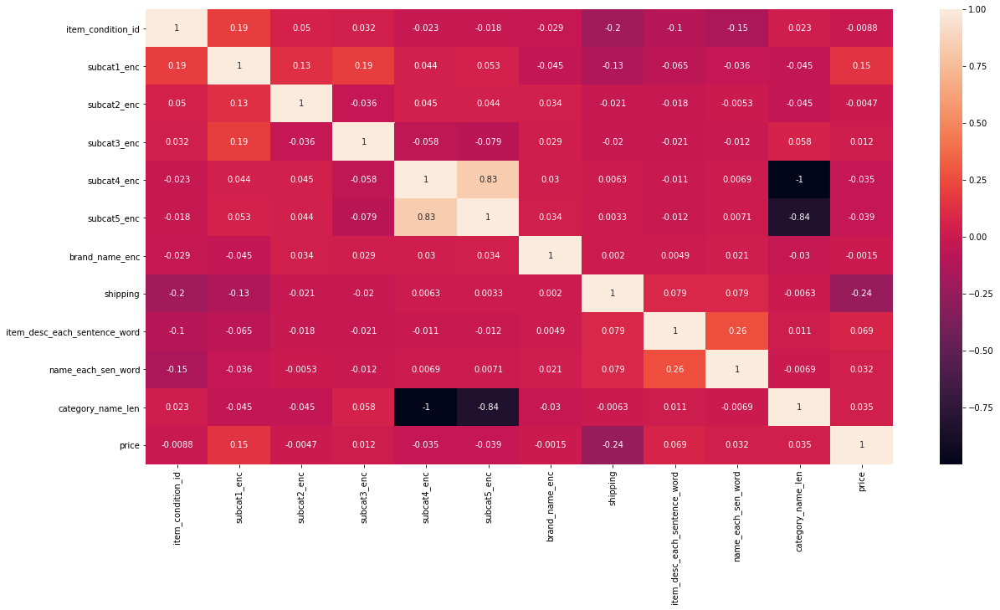

In [94]:
plt.figure(figsize=(20,10))
sns.heatmap(corr_arr,xticklabels=list_col,yticklabels=list_col ,annot=corr_arr)

In [96]:
df.drop(columns=['subcat1_enc','subcat2_enc','subcat3_enc','subcat4_enc','subcat5_enc','brand_name_enc'],inplace=True)

In [97]:
df.to_csv('preprocessed1.csv',index=False)

In [107]:
df1=pd.read_csv('mercari-price-suggestion-challenge/test.tsv', sep='\t')
df1.head()

,test_id,name,item_condition_id,category_name,brand_name,shipping,item_description
0,0,"Breast cancer ""I fight like a girl"" ring",1,Women/Jewelry/Rings,NaN,1,Size 7
1,1,"25 pcs NEW 7.5""x12"" Kraft Bubble Mailers",1,Other/Office supplies/Shipping Supplies,NaN,1,"25 pcs NEW 7.5""x12"" Kraft Bubble Mailers Lined..."
2,2,Coach bag,1,Vintage & Collectibles/Bags and Purses/Handbag,Coach,1,Brand new coach bag. Bought for [rm] at a Coac...
3,3,Floral Kimono,2,Women/Sweaters/Cardigan,NaN,0,-floral kimono -never worn -lightweight and pe...
4,4,Life after Death,3,Other/Books/Religion & Spirituality,NaN,1,Rediscovering life after the loss of a loved o...


In [108]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693359 entries, 0 to 693358
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   test_id            693359 non-null  int64 
 1   name               693359 non-null  object
 2   item_condition_id  693359 non-null  int64 
 3   category_name      690301 non-null  object
 4   brand_name         397834 non-null  object
 5   shipping           693359 non-null  int64 
 6   item_description   693359 non-null  object
dtypes: int64(3), object(4)
memory usage: 37.0+ MB


In [109]:
def preprocessing_text_data(df1):
    
    df1['name']=preprocess_text_data(df1['name'].values)
    df1['brand_name']=df1['brand_name'].apply(lambda x:str(x).lower())
    df1['category_name_len']=df1['category_name'].apply(lambda x:len(x.split('/')))
    df1['subcat1']=df1['category_name'].apply(lambda x:x.split('/')[0])
    df1['subcat2']=df1['category_name'].apply(lambda x:x.split('/')[1])
    df1['subcat3']=df1['category_name'].apply(lambda x:x.split('/')[2])
    df1['subcat4']=df1['category_name'].apply(subcat4_fun)
    df1['subcat5']=df1['category_name'].apply(subcat5_fun)
    df1['item_description']=preprocess_text_data(df1['item_description'].values)
    df1['item_description']=df1['item_description'].apply(lambda x:'_'.join(x.split()) if x == 'description yet' else x)
    df1['name_each_sen_word']=df1['name'].apply(lambda x:len(x.split()))
    df1['item_desc_each_sentence_word']=df1['item_description'].apply(lambda x:len(x.split()))
    df1=df1.dropna(subset=['category_name'])
    
#     df1['category_name_len']=df1['category_name'].apply(lambda x:len(x.split('/')))
    return df1

In [110]:
df1=preprocessing_text_data(df1)

100%|███████████████████████████████████████████████████████████████████████| 690301/690301 [00:26<00:00, 26378.48it/s]
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\vishw\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\v

In [112]:
df1.to_csv('test_preprocessed.csv',index=False)

In [111]:
df1.head()

,test_id,name,item_condition_id,category_name,brand_name,shipping,item_description,category_name_len,subcat1,subcat2,subcat3,subcat4,subcat5,name_each_sen_word,item_desc_each_sentence_word
0,0,breast cancer fight like girl ring,1,Women/Jewelry/Rings,nan,1,size,3,Women,Jewelry,Rings,nan,nan,6,1
1,1,pc new x kraft bubble mailer,1,Other/Office supplies/Shipping Supplies,nan,1,pc new x kraft bubble mailer lined bubble wrap...,3,Other,Office supplies,Shipping Supplies,nan,nan,6,31
2,2,coach bag,1,Vintage & Collectibles/Bags and Purses/Handbag,coach,1,brand new coach bag bought coach outlet,3,Vintage & Collectibles,Bags and Purses,Handbag,nan,nan,2,7
3,3,floral kimono,2,Women/Sweaters/Cardigan,nan,0,floral kimono never worn lightweight perfect h...,3,Women,Sweaters,Cardigan,nan,nan,2,8
4,4,life death,3,Other/Books/Religion & Spirituality,nan,1,rediscovering life loss loved one tony cooke p...,3,Other,Books,Religion & Spirituality,nan,nan,2,17


In [106]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1476208 entries, 0 to 1476207
Data columns (total 16 columns):
 #   Column                        Non-Null Count    Dtype  
---  ------                        --------------    -----  
 0   train_id                      1476208 non-null  int64  
 1   name                          1476208 non-null  object 
 2   item_condition_id             1476208 non-null  int64  
 3   category_name                 1476208 non-null  object 
 4   brand_name                    1476208 non-null  object 
 5   price                         1476208 non-null  float64
 6   shipping                      1476208 non-null  int64  
 7   item_description              1476208 non-null  object 
 8   category_name_len             1476208 non-null  int64  
 9   subcat1                       1476208 non-null  object 
 10  subcat2                       1476208 non-null  object 
 11  subcat3                       1476208 non-null  object 
 12  subcat4                     